# ADRL Assignment 2 <br>
## Team:<br>
#### Anmol Anil Dhanuka (SR No: 21989)<br>
#### Sharath C R (SR No: 21744)<br>
#### Unity Chachei (SR No: 21916) <br>

In [ ]:
!pip install pytorch-ignite

# Problem 1:

## Deep Convolution GAN

In [ ]:
import os
import torch
import random
import numpy as np
import torch.nn as nn
from tqdm import tqdm
import torch.nn.parallel
from torch.optim import Adam
import torch.nn.functional as F
import torch.optim as optim
import matplotlib.pyplot as plt
from IPython.display import HTML
from torchvision import datasets
import torchvision.utils as vutils
import torchvision.datasets as dset
from torch.utils.data import DataLoader
import matplotlib.animation as animation
import torchvision.transforms as transforms
from mpl_toolkits.axes_grid1 import ImageGrid
from torchvision.utils import save_image, make_grid
from torch.distributions import MultivariateNormal
import matplotlib.pyplot as plt

# Required for FID
from ignite.metrics import FID
from ignite.engine import Engine
import PIL.Image as Image
from torch.utils.data import SubsetRandomSampler

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# Input Controls

batch_size = 128 # Batch size
image_size = 128 # Image size (128x128)
img_channels = 3 # Image Channels
n_gpu = 1 # GPUs available
g_hidden_dim = 64 # Hidden layers in CNN for Generator
d_hidden_dim = 64 # Hidden layers in CNN for Discriminator
z_dim = 100 # Latent Dimension
num_epochs = 200 # Epochs

# Opt parameters
lr = 0.0002 # Learning rate
beta1 = 0.5 # beta
reproducible_results = False # Reuse seed
seed = 616 # Seed value

# Data loading
transform = transforms.Compose(
    [
        transforms.Resize(size=image_size),
        transforms.ToTensor(),
        #transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
    ]

)
#data_path = '/content/drive/MyDrive/ADRL Assignment/data/train/'
data_path = '.\\archive\\afhq\\train\\'
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
train_data = datasets.ImageFolder(data_path, transform=transform)
#train_data = datasets.ImageFolder(data_path,transform=transform)

train_loader = DataLoader(train_data,batch_size=batch_size,shuffle=True,num_workers=2)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [ ]:
if reproducible_results:
    print("Random Seed: ", seed)
    random.seed(seed)
    torch.manual_seed(seed)
    torch.use_deterministic_algorithms(True)

In [ ]:
## To facilitate running multiple experiments. But we never got to it.

def initialize_cnn_weights(nn_class, init_type='normal'):
    cls_name = nn_class.__class__.__name__
    if init_type=='normal':
        if cls_name.find('Conv') != -1:
            nn.init.normal_(nn_class.weight.data, 0.0, 0.02)
        elif cls_name.find('BatchNorm') != -1:
            nn.init.normal_(nn_class.weight.data, 1.0, 0.02)
            nn.init.constant_(nn_class.bias.data, 0)
    elif init_type=='glorot':
        if cls_name.find('Conv') != -1:
            nn.init.xavier_uniform_(nn_class.weight.data, 0.0, 0.02)
        elif cls_name.find('BatchNorm') != -1:
            nn.init.xavier_uniform_(nn_class.weight.data, 1.0, 0.02)
            nn.init.constant_(nn_class.bias.data, 0)
    elif init_type=='uniform':
        if cls_name.find('Conv') != -1:
            nn.init.uniform_(nn_class.weight.data, 0.0, 0.02)
        elif cls_name.find('BatchNorm') != -1:
            nn.init.uniform_(nn_class.weight.data, 1.0, 0.02)
            nn.init.constant_(nn_class.bias.data, 0)

In [ ]:
class Generator(nn.Module):
    """
    Generator network with CNN.
    Image dimension:
    H_out = (H_in - 1)*stride - 2*padding + dilation*(kernel_size-1) + output_pad + 1
    Defaults:
        #   stride: 1
        #   padding: 0
        #   dilation: 1
    """
    def __init__(self, n_gpu):
        super(Generator, self).__init__()
        self.n_gpu = n_gpu
        self.seq = nn.Sequential(
            # input is Z (1*1*1), going into a convolution => 512*4*4
            nn.ConvTranspose2d( z_dim, g_hidden_dim * 16, 4, 1, 0, bias=False),
            nn.BatchNorm2d(g_hidden_dim * 16),
            nn.ReLU(True),
            # 256*8*8
            nn.ConvTranspose2d(g_hidden_dim * 16, g_hidden_dim * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(g_hidden_dim * 8),
            nn.ReLU(True),
            # (g_hidden_dim*4) x 8 x 8
            nn.ConvTranspose2d( g_hidden_dim * 8, g_hidden_dim * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(g_hidden_dim * 4),
            nn.ReLU(True),
            # (ng_hidden_dimgf*2) x 16 x 16
            nn.ConvTranspose2d( g_hidden_dim * 4, g_hidden_dim*2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(g_hidden_dim*2),
            nn.ReLU(True),
            # (g_hidden_dim) x 32 x 32
            nn.ConvTranspose2d( g_hidden_dim*2, g_hidden_dim, 4, 2, 1, bias=False),
            nn.BatchNorm2d(g_hidden_dim),
            nn.ReLU(True),   #(32*64*64)
            nn.ConvTranspose2d( g_hidden_dim, img_channels, 4, 2, 1, bias=False),
            nn.Tanh()
            # (img_channels) x 128 x 128
        )

    def forward(self, input):
        return self.seq(input)

In [ ]:
class Discriminator(nn.Module):
    """
    Discriminator Network.
    H_out = ((H_in + 2*padding - dilation*(kernel_size-1) - 1)/stride) + 1
    """
    def __init__(self, n_gpu):
        super(Discriminator, self).__init__()
        self.n_gpu = n_gpu
        self.seq = nn.Sequential(
            # 3*128*128
            nn.Conv2d(img_channels, d_hidden_dim, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # 64*64*64
            nn.Conv2d(d_hidden_dim, d_hidden_dim * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(d_hidden_dim * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # 128*32*32
            nn.Conv2d(d_hidden_dim * 2, d_hidden_dim * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(d_hidden_dim * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # 256*16*16
            nn.Conv2d(d_hidden_dim * 4, d_hidden_dim * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(d_hidden_dim * 8),
            nn.LeakyReLU(0.2, inplace=True),
            #  512*8*8
            nn.Conv2d(d_hidden_dim * 8, d_hidden_dim * 4, 4, 1, 0, bias=False),  #512*5*5
            nn.BatchNorm2d(d_hidden_dim * 4),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(d_hidden_dim * 4, 1, 5, 1, 0, bias=False),  #1*1*1
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.seq(input)

In [ ]:
# Initalize Generator
generator = Generator(n_gpu).to(device)
if (device.type == 'cuda') and (n_gpu > 1):
    generator = nn.DataParallel(generator, list(range(n_gpu)))
initialize_cnn_weights(generator, 'normal')

# Initialize Discriminator
discriminator = Discriminator(n_gpu).to(device)
if (device.type == 'cuda') and (n_gpu > 1):
    discriminator = nn.DataParallel(discriminator, list(range(n_gpu)))
initialize_cnn_weights(discriminator, 'normal')

# Print the model for debug
print(generator)
print(discriminator)

Generator(
  (seq): Sequential(
    (0): ConvTranspose2d(100, 1024, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(1024, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): BatchNo

In [ ]:
# Initialize loss function
criterion = nn.BCELoss()

# Real and Fake labels for training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both Generator and Discriminator
optimizerD = optim.Adam(discriminator.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(generator.parameters(), lr=lr, betas=(beta1, 0.999))

In [ ]:
def show_tensor_images(tensor_img, title, num_img=100):
    unflat_img = tensor_img.detach().cpu()
    img_grid = make_grid(unflat_img[:num_img], nrow=10)
    plt.figure(figsize=(12, 12))
    plt.imshow(img_grid.permute(1, 2, 0).squeeze())
    plt.title(title)
    plt.show()

# Experiment 1: Same number of Generator and Discriminator train iterations

### Parameters

- Epochs : 200
- Learning rate: 2e-4
- Latent dimensions: 100
- Batch Size = 128
- Discriminator to Generator training ratio : 1


### Observations:

- The generated images are comparable to the true images indicating that $P_{x}$ is close to $P_{\hat{x}}$
- The losses have converged to optimal value and are not varying. Further experiments with number of epochs can be tried to get even better loss case
- The FID score improves on increasing the number of images from 1000 to 5000

100%|██████████| 115/115 [00:17<00:00,  6.67it/s]



Epoch: 1/200: Generator loss: 5.7888, Discriminator loss: 0.3361


100%|██████████| 115/115 [00:14<00:00,  7.74it/s]



Epoch: 2/200: Generator loss: 4.6734, Discriminator loss: 0.4186


100%|██████████| 115/115 [00:14<00:00,  7.98it/s]



Epoch: 3/200: Generator loss: 4.9926, Discriminator loss: 0.3517


100%|██████████| 115/115 [00:14<00:00,  7.96it/s]



Epoch: 4/200: Generator loss: 4.8732, Discriminator loss: 0.5170


100%|██████████| 115/115 [00:14<00:00,  8.15it/s]



Epoch: 5/200: Generator loss: 4.9117, Discriminator loss: 0.4324


100%|██████████| 115/115 [00:14<00:00,  8.13it/s]



Epoch: 6/200: Generator loss: 5.1090, Discriminator loss: 0.3996


100%|██████████| 115/115 [00:14<00:00,  7.95it/s]



Epoch: 7/200: Generator loss: 5.2960, Discriminator loss: 0.4079


100%|██████████| 115/115 [00:14<00:00,  7.89it/s]



Epoch: 8/200: Generator loss: 5.5306, Discriminator loss: 0.4299


100%|██████████| 115/115 [00:14<00:00,  7.97it/s]



Epoch: 9/200: Generator loss: 5.7295, Discriminator loss: 0.4114


100%|██████████| 115/115 [00:14<00:00,  8.09it/s]



Epoch: 10/200: Generator loss: 5.6357, Discriminator loss: 0.4841


100%|██████████| 115/115 [00:14<00:00,  7.84it/s]



Epoch: 11/200: Generator loss: 5.7263, Discriminator loss: 0.4237


100%|██████████| 115/115 [00:14<00:00,  7.83it/s]



Epoch: 12/200: Generator loss: 5.8532, Discriminator loss: 0.4150


100%|██████████| 115/115 [00:14<00:00,  8.05it/s]



Epoch: 13/200: Generator loss: 5.7736, Discriminator loss: 0.4584


100%|██████████| 115/115 [00:14<00:00,  7.98it/s]



Epoch: 14/200: Generator loss: 5.9223, Discriminator loss: 0.4428


100%|██████████| 115/115 [00:14<00:00,  8.08it/s]



Epoch: 15/200: Generator loss: 5.5807, Discriminator loss: 0.4857


100%|██████████| 115/115 [00:14<00:00,  8.05it/s]



Epoch: 16/200: Generator loss: 5.7591, Discriminator loss: 0.3902


100%|██████████| 115/115 [00:14<00:00,  8.05it/s]



Epoch: 17/200: Generator loss: 6.0922, Discriminator loss: 0.4202


100%|██████████| 115/115 [00:14<00:00,  7.96it/s]



Epoch: 18/200: Generator loss: 5.7405, Discriminator loss: 0.4163


100%|██████████| 115/115 [00:14<00:00,  8.02it/s]



Epoch: 19/200: Generator loss: 5.5902, Discriminator loss: 0.3987


100%|██████████| 115/115 [00:14<00:00,  7.84it/s]



Epoch: 20/200: Generator loss: 5.6602, Discriminator loss: 0.3912


100%|██████████| 115/115 [00:14<00:00,  7.74it/s]



Epoch: 21/200: Generator loss: 5.7005, Discriminator loss: 0.3394


100%|██████████| 115/115 [00:14<00:00,  7.93it/s]



Epoch: 22/200: Generator loss: 5.8560, Discriminator loss: 0.3097


100%|██████████| 115/115 [00:14<00:00,  7.92it/s]



Epoch: 23/200: Generator loss: 5.9951, Discriminator loss: 0.3399


100%|██████████| 115/115 [00:14<00:00,  7.88it/s]



Epoch: 24/200: Generator loss: 6.1564, Discriminator loss: 0.3900


100%|██████████| 115/115 [00:14<00:00,  7.87it/s]



Epoch: 25/200: Generator loss: 5.7923, Discriminator loss: 0.4273


100%|██████████| 115/115 [00:14<00:00,  7.78it/s]



Epoch: 26/200: Generator loss: 6.0637, Discriminator loss: 0.3643


100%|██████████| 115/115 [00:14<00:00,  7.72it/s]



Epoch: 27/200: Generator loss: 6.1544, Discriminator loss: 0.3920


100%|██████████| 115/115 [00:14<00:00,  7.88it/s]



Epoch: 28/200: Generator loss: 6.2030, Discriminator loss: 0.3212


100%|██████████| 115/115 [00:14<00:00,  7.86it/s]



Epoch: 29/200: Generator loss: 6.1518, Discriminator loss: 0.3497


100%|██████████| 115/115 [00:14<00:00,  7.77it/s]



Epoch: 30/200: Generator loss: 6.1185, Discriminator loss: 0.3100


100%|██████████| 115/115 [00:14<00:00,  7.69it/s]



Epoch: 31/200: Generator loss: 6.4255, Discriminator loss: 0.3466


100%|██████████| 115/115 [00:14<00:00,  7.71it/s]



Epoch: 32/200: Generator loss: 6.3796, Discriminator loss: 0.3104


100%|██████████| 115/115 [00:14<00:00,  7.99it/s]



Epoch: 33/200: Generator loss: 6.5726, Discriminator loss: 0.3358


100%|██████████| 115/115 [00:14<00:00,  8.02it/s]



Epoch: 34/200: Generator loss: 6.0865, Discriminator loss: 0.3093


100%|██████████| 115/115 [00:14<00:00,  7.80it/s]



Epoch: 35/200: Generator loss: 6.2722, Discriminator loss: 0.3467


100%|██████████| 115/115 [00:14<00:00,  7.96it/s]



Epoch: 36/200: Generator loss: 6.1797, Discriminator loss: 0.2773


100%|██████████| 115/115 [00:14<00:00,  7.78it/s]



Epoch: 37/200: Generator loss: 6.4467, Discriminator loss: 0.2919


100%|██████████| 115/115 [00:14<00:00,  7.71it/s]



Epoch: 38/200: Generator loss: 6.2407, Discriminator loss: 0.2880


100%|██████████| 115/115 [00:14<00:00,  7.87it/s]



Epoch: 39/200: Generator loss: 6.4180, Discriminator loss: 0.2883


100%|██████████| 115/115 [00:14<00:00,  7.85it/s]



Epoch: 40/200: Generator loss: 6.6558, Discriminator loss: 0.3495


100%|██████████| 115/115 [00:14<00:00,  7.76it/s]



Epoch: 41/200: Generator loss: 6.2243, Discriminator loss: 0.2090


100%|██████████| 115/115 [00:14<00:00,  7.92it/s]



Epoch: 42/200: Generator loss: 6.4270, Discriminator loss: 0.4049


100%|██████████| 115/115 [00:14<00:00,  7.81it/s]



Epoch: 43/200: Generator loss: 6.1550, Discriminator loss: 0.3053


100%|██████████| 115/115 [00:14<00:00,  7.97it/s]



Epoch: 44/200: Generator loss: 6.0895, Discriminator loss: 0.2122


100%|██████████| 115/115 [00:14<00:00,  7.96it/s]



Epoch: 45/200: Generator loss: 6.3764, Discriminator loss: 0.3187


100%|██████████| 115/115 [00:14<00:00,  7.80it/s]



Epoch: 46/200: Generator loss: 6.3461, Discriminator loss: 0.2358


100%|██████████| 115/115 [00:14<00:00,  7.79it/s]



Epoch: 47/200: Generator loss: 6.4291, Discriminator loss: 0.2102


100%|██████████| 115/115 [00:14<00:00,  7.89it/s]



Epoch: 48/200: Generator loss: 6.8816, Discriminator loss: 0.3543


100%|██████████| 115/115 [00:15<00:00,  7.64it/s]



Epoch: 49/200: Generator loss: 6.1381, Discriminator loss: 0.2485


100%|██████████| 115/115 [00:14<00:00,  7.80it/s]



Epoch: 50/200: Generator loss: 6.2349, Discriminator loss: 0.1958


  0%|          | 0/115 [00:00<?, ?it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epcoh 50: Generator loss: 5.950070240926253, discriminator loss: 0.35630652396138895


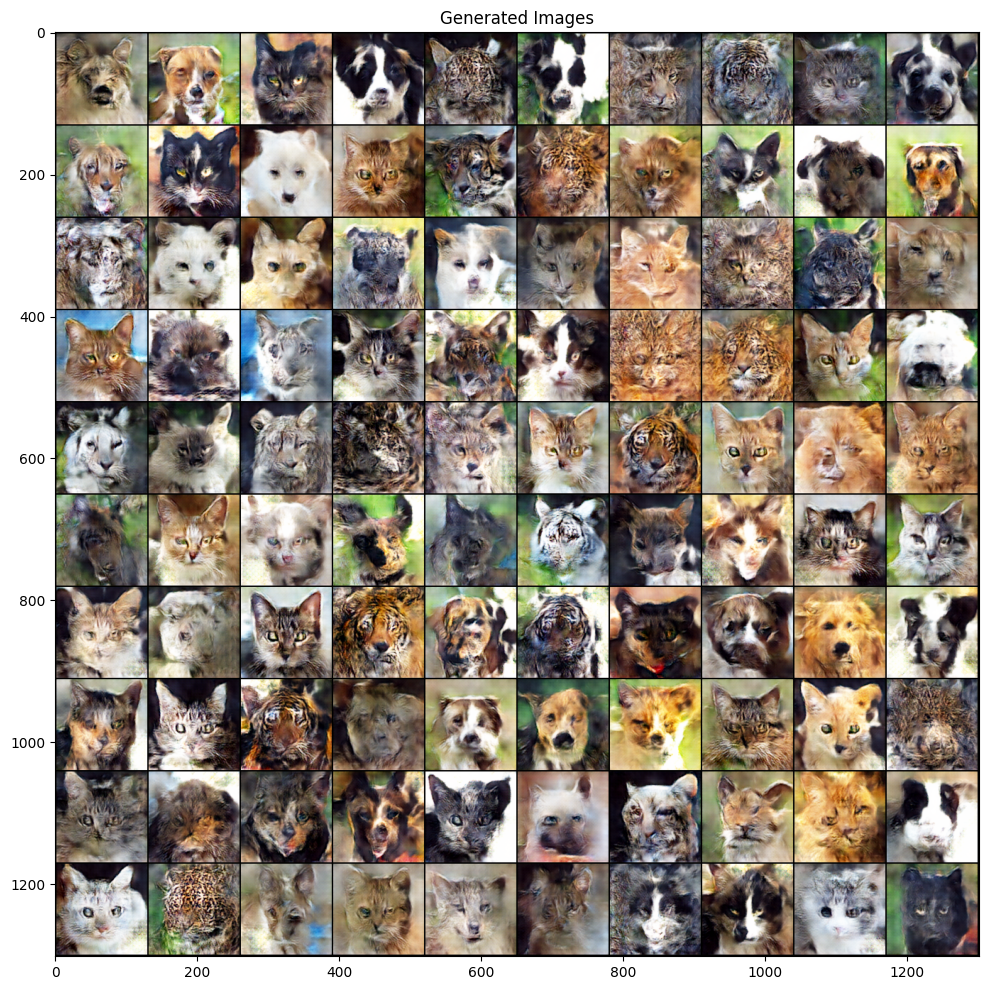

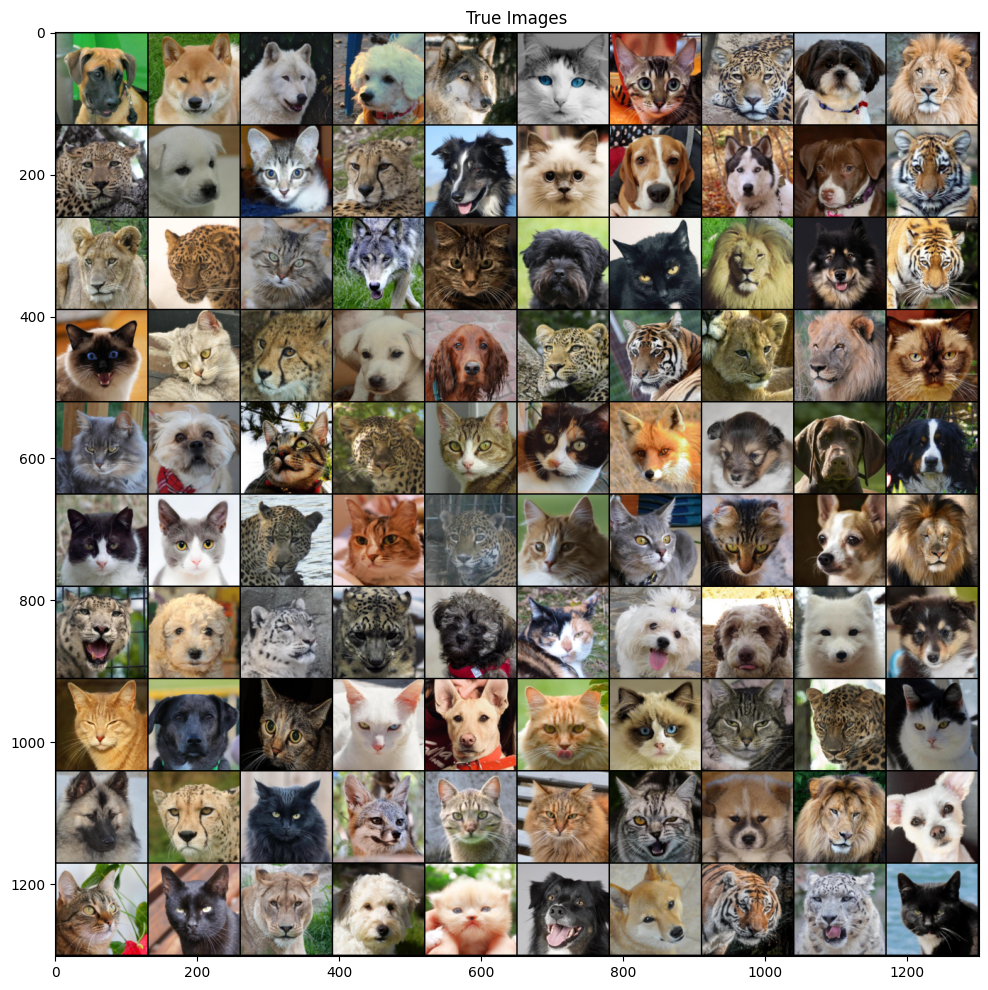

100%|██████████| 115/115 [00:15<00:00,  7.25it/s]



Epoch: 51/200: Generator loss: 6.6823, Discriminator loss: 0.2205


100%|██████████| 115/115 [00:14<00:00,  7.83it/s]



Epoch: 52/200: Generator loss: 6.8106, Discriminator loss: 0.4224


100%|██████████| 115/115 [00:14<00:00,  7.90it/s]



Epoch: 53/200: Generator loss: 5.5356, Discriminator loss: 0.1535


100%|██████████| 115/115 [00:14<00:00,  8.00it/s]



Epoch: 54/200: Generator loss: 6.5160, Discriminator loss: 0.3457


100%|██████████| 115/115 [00:14<00:00,  7.89it/s]



Epoch: 55/200: Generator loss: 6.2803, Discriminator loss: 0.2451


100%|██████████| 115/115 [00:14<00:00,  7.92it/s]



Epoch: 56/200: Generator loss: 6.0858, Discriminator loss: 0.1992


100%|██████████| 115/115 [00:14<00:00,  7.95it/s]



Epoch: 57/200: Generator loss: 6.5459, Discriminator loss: 0.3646


100%|██████████| 115/115 [00:14<00:00,  7.88it/s]



Epoch: 58/200: Generator loss: 5.9541, Discriminator loss: 0.3105


100%|██████████| 115/115 [00:14<00:00,  7.98it/s]



Epoch: 59/200: Generator loss: 6.4753, Discriminator loss: 0.2739


100%|██████████| 115/115 [00:14<00:00,  7.92it/s]



Epoch: 60/200: Generator loss: 6.4613, Discriminator loss: 0.2802


100%|██████████| 115/115 [00:14<00:00,  7.95it/s]



Epoch: 61/200: Generator loss: 5.4707, Discriminator loss: 0.1524


100%|██████████| 115/115 [00:14<00:00,  7.93it/s]



Epoch: 62/200: Generator loss: 5.9660, Discriminator loss: 0.2710


100%|██████████| 115/115 [00:14<00:00,  7.92it/s]



Epoch: 63/200: Generator loss: 6.7062, Discriminator loss: 0.3657


100%|██████████| 115/115 [00:14<00:00,  7.70it/s]



Epoch: 64/200: Generator loss: 5.4864, Discriminator loss: 0.1549


100%|██████████| 115/115 [00:14<00:00,  7.89it/s]



Epoch: 65/200: Generator loss: 6.1662, Discriminator loss: 0.3530


100%|██████████| 115/115 [00:14<00:00,  7.84it/s]



Epoch: 66/200: Generator loss: 6.1143, Discriminator loss: 0.1860


100%|██████████| 115/115 [00:14<00:00,  7.91it/s]



Epoch: 67/200: Generator loss: 6.1825, Discriminator loss: 0.4364


100%|██████████| 115/115 [00:14<00:00,  7.82it/s]



Epoch: 68/200: Generator loss: 5.6370, Discriminator loss: 0.1723


100%|██████████| 115/115 [00:14<00:00,  8.05it/s]



Epoch: 69/200: Generator loss: 6.2523, Discriminator loss: 0.2659


100%|██████████| 115/115 [00:14<00:00,  7.99it/s]



Epoch: 70/200: Generator loss: 6.1326, Discriminator loss: 0.2384


100%|██████████| 115/115 [00:14<00:00,  7.96it/s]



Epoch: 71/200: Generator loss: 6.2252, Discriminator loss: 0.1857


100%|██████████| 115/115 [00:14<00:00,  7.81it/s]



Epoch: 72/200: Generator loss: 6.3319, Discriminator loss: 0.3221


100%|██████████| 115/115 [00:14<00:00,  7.85it/s]



Epoch: 73/200: Generator loss: 6.6880, Discriminator loss: 0.2970


100%|██████████| 115/115 [00:14<00:00,  7.77it/s]



Epoch: 74/200: Generator loss: 5.7484, Discriminator loss: 0.1949


100%|██████████| 115/115 [00:14<00:00,  7.83it/s]



Epoch: 75/200: Generator loss: 6.1607, Discriminator loss: 0.2297


100%|██████████| 115/115 [00:14<00:00,  7.82it/s]



Epoch: 76/200: Generator loss: 5.6451, Discriminator loss: 0.2188


100%|██████████| 115/115 [00:14<00:00,  7.88it/s]



Epoch: 77/200: Generator loss: 6.1291, Discriminator loss: 0.1825


100%|██████████| 115/115 [00:14<00:00,  7.74it/s]



Epoch: 78/200: Generator loss: 6.4015, Discriminator loss: 0.4151


100%|██████████| 115/115 [00:14<00:00,  7.84it/s]



Epoch: 79/200: Generator loss: 5.4874, Discriminator loss: 0.1485


100%|██████████| 115/115 [00:14<00:00,  7.94it/s]



Epoch: 80/200: Generator loss: 5.9684, Discriminator loss: 0.2357


100%|██████████| 115/115 [00:14<00:00,  7.95it/s]



Epoch: 81/200: Generator loss: 6.1641, Discriminator loss: 0.1883


100%|██████████| 115/115 [00:14<00:00,  7.78it/s]



Epoch: 82/200: Generator loss: 6.0600, Discriminator loss: 0.3787


100%|██████████| 115/115 [00:14<00:00,  7.89it/s]



Epoch: 83/200: Generator loss: 6.0461, Discriminator loss: 0.2635


100%|██████████| 115/115 [00:14<00:00,  7.90it/s]



Epoch: 84/200: Generator loss: 5.7778, Discriminator loss: 0.1616


100%|██████████| 115/115 [00:14<00:00,  7.81it/s]



Epoch: 85/200: Generator loss: 5.8728, Discriminator loss: 0.2806


100%|██████████| 115/115 [00:14<00:00,  7.74it/s]



Epoch: 86/200: Generator loss: 6.0632, Discriminator loss: 0.2531


100%|██████████| 115/115 [00:14<00:00,  7.82it/s]



Epoch: 87/200: Generator loss: 5.8655, Discriminator loss: 0.2736


100%|██████████| 115/115 [00:14<00:00,  7.81it/s]



Epoch: 88/200: Generator loss: 5.5083, Discriminator loss: 0.1283


100%|██████████| 115/115 [00:14<00:00,  7.80it/s]



Epoch: 89/200: Generator loss: 5.9289, Discriminator loss: 0.2745


100%|██████████| 115/115 [00:14<00:00,  8.01it/s]



Epoch: 90/200: Generator loss: 6.2055, Discriminator loss: 0.3109


100%|██████████| 115/115 [00:14<00:00,  7.78it/s]



Epoch: 91/200: Generator loss: 5.8854, Discriminator loss: 0.1922


100%|██████████| 115/115 [00:14<00:00,  7.77it/s]



Epoch: 92/200: Generator loss: 5.7369, Discriminator loss: 0.3456


100%|██████████| 115/115 [00:14<00:00,  7.74it/s]



Epoch: 93/200: Generator loss: 5.8218, Discriminator loss: 0.1880


100%|██████████| 115/115 [00:15<00:00,  7.63it/s]



Epoch: 94/200: Generator loss: 5.7168, Discriminator loss: 0.3032


100%|██████████| 115/115 [00:14<00:00,  7.87it/s]



Epoch: 95/200: Generator loss: 5.5736, Discriminator loss: 0.2158


100%|██████████| 115/115 [00:14<00:00,  7.85it/s]



Epoch: 96/200: Generator loss: 5.8315, Discriminator loss: 0.1455


100%|██████████| 115/115 [00:14<00:00,  7.91it/s]



Epoch: 97/200: Generator loss: 6.0061, Discriminator loss: 0.1713


100%|██████████| 115/115 [00:14<00:00,  7.89it/s]



Epoch: 98/200: Generator loss: 5.8619, Discriminator loss: 0.0961


100%|██████████| 115/115 [00:14<00:00,  7.73it/s]



Epoch: 99/200: Generator loss: 6.3435, Discriminator loss: 0.3559


100%|██████████| 115/115 [00:14<00:00,  7.73it/s]



Epoch: 100/200: Generator loss: 6.0342, Discriminator loss: 0.1969


  0%|          | 0/115 [00:00<?, ?it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epcoh 100: Generator loss: 5.999853191605916, discriminator loss: 0.3037704955998628


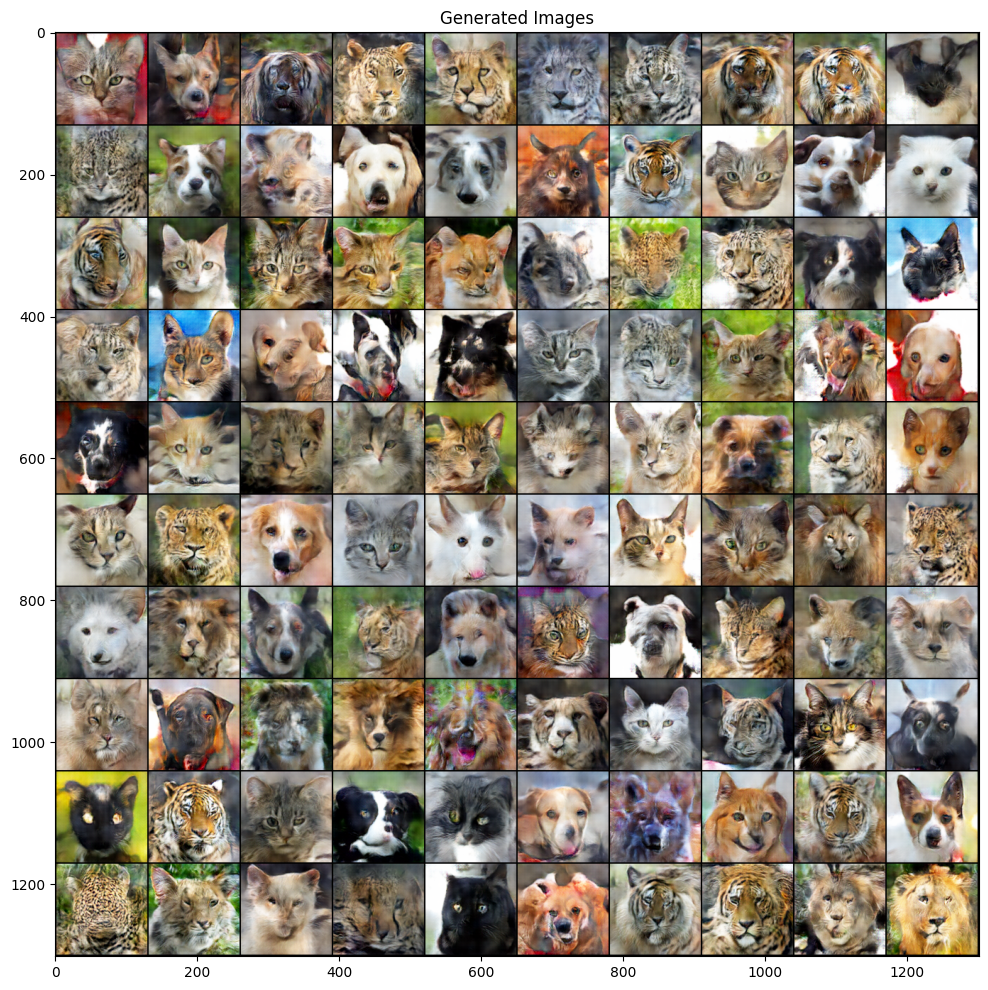

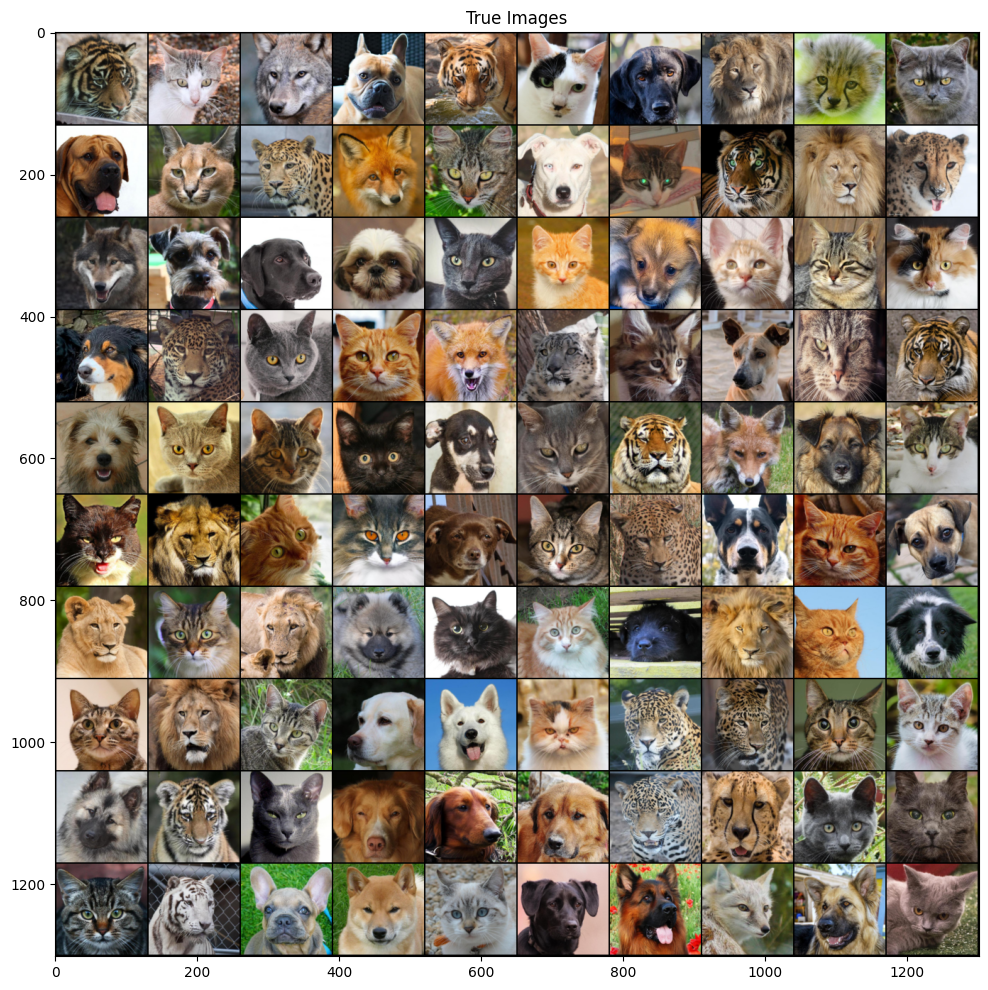

100%|██████████| 115/115 [00:15<00:00,  7.35it/s]



Epoch: 101/200: Generator loss: 5.7634, Discriminator loss: 0.1138


100%|██████████| 115/115 [00:15<00:00,  7.66it/s]



Epoch: 102/200: Generator loss: 5.9608, Discriminator loss: 0.2234


100%|██████████| 115/115 [00:14<00:00,  7.86it/s]



Epoch: 103/200: Generator loss: 6.0088, Discriminator loss: 0.1164


100%|██████████| 115/115 [00:14<00:00,  7.89it/s]



Epoch: 104/200: Generator loss: 6.7526, Discriminator loss: 0.2606


100%|██████████| 115/115 [00:14<00:00,  7.82it/s]



Epoch: 105/200: Generator loss: 6.1090, Discriminator loss: 0.1036


100%|██████████| 115/115 [00:14<00:00,  7.93it/s]



Epoch: 106/200: Generator loss: 6.7741, Discriminator loss: 0.1866


100%|██████████| 115/115 [00:14<00:00,  7.75it/s]



Epoch: 107/200: Generator loss: 6.2563, Discriminator loss: 0.1291


100%|██████████| 115/115 [00:14<00:00,  7.73it/s]



Epoch: 108/200: Generator loss: 6.2405, Discriminator loss: 0.0855


100%|██████████| 115/115 [00:14<00:00,  7.89it/s]



Epoch: 109/200: Generator loss: 6.5128, Discriminator loss: 0.2945


100%|██████████| 115/115 [00:14<00:00,  7.73it/s]



Epoch: 110/200: Generator loss: 6.9451, Discriminator loss: 0.2589


100%|██████████| 115/115 [00:14<00:00,  7.81it/s]



Epoch: 111/200: Generator loss: 6.4351, Discriminator loss: 0.2133


100%|██████████| 115/115 [00:14<00:00,  7.96it/s]



Epoch: 112/200: Generator loss: 6.6307, Discriminator loss: 0.2293


100%|██████████| 115/115 [00:14<00:00,  7.91it/s]



Epoch: 113/200: Generator loss: 6.2241, Discriminator loss: 0.1470


100%|██████████| 115/115 [00:14<00:00,  7.89it/s]



Epoch: 114/200: Generator loss: 5.7228, Discriminator loss: 0.0819


100%|██████████| 115/115 [00:14<00:00,  7.94it/s]



Epoch: 115/200: Generator loss: 5.7927, Discriminator loss: 0.1382


100%|██████████| 115/115 [00:14<00:00,  8.03it/s]



Epoch: 116/200: Generator loss: 7.4561, Discriminator loss: 0.2519


100%|██████████| 115/115 [00:14<00:00,  7.91it/s]



Epoch: 117/200: Generator loss: 6.3016, Discriminator loss: 0.1036


100%|██████████| 115/115 [00:14<00:00,  8.06it/s]



Epoch: 118/200: Generator loss: 6.2698, Discriminator loss: 0.1398


100%|██████████| 115/115 [00:14<00:00,  7.94it/s]



Epoch: 119/200: Generator loss: 6.8445, Discriminator loss: 0.2171


100%|██████████| 115/115 [00:14<00:00,  7.92it/s]



Epoch: 120/200: Generator loss: 5.8700, Discriminator loss: 0.0690


100%|██████████| 115/115 [00:14<00:00,  8.10it/s]



Epoch: 121/200: Generator loss: 6.7843, Discriminator loss: 0.3601


100%|██████████| 115/115 [00:14<00:00,  8.08it/s]



Epoch: 122/200: Generator loss: 6.5260, Discriminator loss: 0.1300


100%|██████████| 115/115 [00:14<00:00,  8.06it/s]



Epoch: 123/200: Generator loss: 5.9987, Discriminator loss: 0.0731


100%|██████████| 115/115 [00:14<00:00,  7.93it/s]



Epoch: 124/200: Generator loss: 6.4098, Discriminator loss: 0.5232


100%|██████████| 115/115 [00:14<00:00,  8.04it/s]



Epoch: 125/200: Generator loss: 6.4229, Discriminator loss: 0.2309


100%|██████████| 115/115 [00:14<00:00,  7.81it/s]



Epoch: 126/200: Generator loss: 5.9629, Discriminator loss: 0.0978


100%|██████████| 115/115 [00:14<00:00,  7.84it/s]



Epoch: 127/200: Generator loss: 6.3167, Discriminator loss: 0.1849


100%|██████████| 115/115 [00:14<00:00,  7.75it/s]



Epoch: 128/200: Generator loss: 5.9891, Discriminator loss: 0.1941


100%|██████████| 115/115 [00:14<00:00,  7.97it/s]



Epoch: 129/200: Generator loss: 6.4803, Discriminator loss: 0.1564


100%|██████████| 115/115 [00:14<00:00,  7.88it/s]



Epoch: 130/200: Generator loss: 6.2173, Discriminator loss: 0.1015


100%|██████████| 115/115 [00:14<00:00,  7.76it/s]



Epoch: 131/200: Generator loss: 6.3349, Discriminator loss: 0.0843


100%|██████████| 115/115 [00:14<00:00,  7.93it/s]



Epoch: 132/200: Generator loss: 5.9308, Discriminator loss: 0.0541


100%|██████████| 115/115 [00:14<00:00,  7.94it/s]



Epoch: 133/200: Generator loss: 7.0737, Discriminator loss: 0.6169


100%|██████████| 115/115 [00:14<00:00,  7.96it/s]



Epoch: 134/200: Generator loss: 6.2315, Discriminator loss: 0.1702


100%|██████████| 115/115 [00:14<00:00,  7.92it/s]



Epoch: 135/200: Generator loss: 6.0012, Discriminator loss: 0.0982


100%|██████████| 115/115 [00:14<00:00,  7.76it/s]



Epoch: 136/200: Generator loss: 6.0910, Discriminator loss: 0.0710


100%|██████████| 115/115 [00:14<00:00,  7.97it/s]



Epoch: 137/200: Generator loss: 5.9544, Discriminator loss: 0.0525


100%|██████████| 115/115 [00:14<00:00,  7.79it/s]



Epoch: 138/200: Generator loss: 6.5839, Discriminator loss: 0.3649


100%|██████████| 115/115 [00:14<00:00,  7.95it/s]



Epoch: 139/200: Generator loss: 6.6430, Discriminator loss: 0.1655


100%|██████████| 115/115 [00:14<00:00,  7.78it/s]



Epoch: 140/200: Generator loss: 6.6530, Discriminator loss: 0.1146


100%|██████████| 115/115 [00:14<00:00,  7.87it/s]



Epoch: 141/200: Generator loss: 6.2537, Discriminator loss: 0.1510


100%|██████████| 115/115 [00:14<00:00,  7.77it/s]



Epoch: 142/200: Generator loss: 6.3235, Discriminator loss: 0.0691


100%|██████████| 115/115 [00:14<00:00,  7.87it/s]



Epoch: 143/200: Generator loss: 6.1685, Discriminator loss: 0.0503


100%|██████████| 115/115 [00:14<00:00,  7.88it/s]



Epoch: 144/200: Generator loss: 6.2669, Discriminator loss: 0.0478


100%|██████████| 115/115 [00:14<00:00,  7.81it/s]



Epoch: 145/200: Generator loss: 6.2898, Discriminator loss: 0.0379


100%|██████████| 115/115 [00:14<00:00,  7.98it/s]



Epoch: 146/200: Generator loss: 6.6779, Discriminator loss: 0.4766


100%|██████████| 115/115 [00:14<00:00,  8.06it/s]



Epoch: 147/200: Generator loss: 7.0973, Discriminator loss: 0.2491


100%|██████████| 115/115 [00:14<00:00,  7.95it/s]



Epoch: 148/200: Generator loss: 6.9433, Discriminator loss: 0.1288


100%|██████████| 115/115 [00:14<00:00,  7.91it/s]



Epoch: 149/200: Generator loss: 6.3684, Discriminator loss: 0.0751


100%|██████████| 115/115 [00:14<00:00,  7.89it/s]



Epoch: 150/200: Generator loss: 6.8246, Discriminator loss: 0.2640


  0%|          | 0/115 [00:00<?, ?it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epcoh 150: Generator loss: 6.124300677021362, discriminator loss: 0.26089361774019887


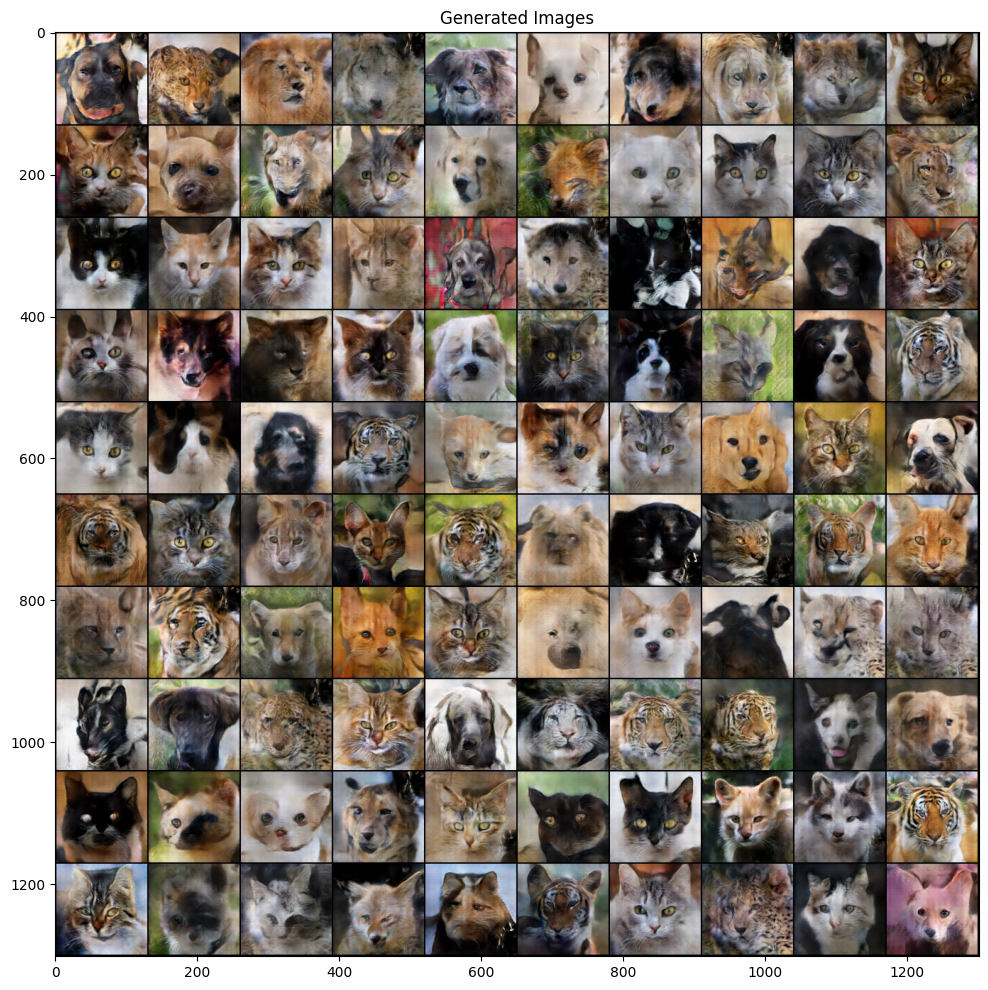

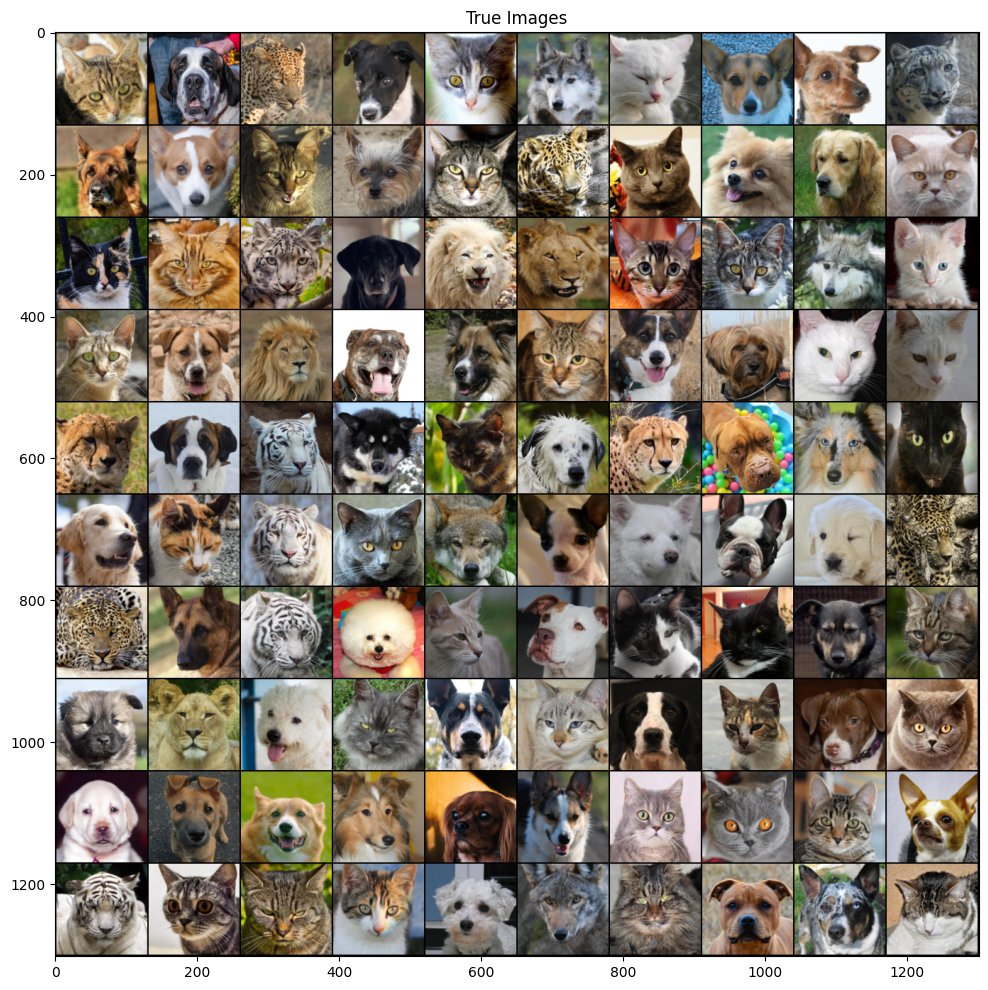

100%|██████████| 115/115 [00:15<00:00,  7.42it/s]



Epoch: 151/200: Generator loss: 6.6799, Discriminator loss: 0.0782


100%|██████████| 115/115 [00:14<00:00,  7.81it/s]



Epoch: 152/200: Generator loss: 6.2537, Discriminator loss: 0.0510


100%|██████████| 115/115 [00:14<00:00,  7.98it/s]



Epoch: 153/200: Generator loss: 6.8906, Discriminator loss: 0.1819


100%|██████████| 115/115 [00:14<00:00,  7.69it/s]



Epoch: 154/200: Generator loss: 6.6959, Discriminator loss: 0.0808


100%|██████████| 115/115 [00:14<00:00,  7.79it/s]



Epoch: 155/200: Generator loss: 6.8283, Discriminator loss: 0.2368


100%|██████████| 115/115 [00:14<00:00,  7.85it/s]



Epoch: 156/200: Generator loss: 6.4028, Discriminator loss: 0.1424


100%|██████████| 115/115 [00:14<00:00,  7.97it/s]



Epoch: 157/200: Generator loss: 6.8047, Discriminator loss: 0.0884


100%|██████████| 115/115 [00:14<00:00,  8.01it/s]



Epoch: 158/200: Generator loss: 6.5578, Discriminator loss: 0.0535


100%|██████████| 115/115 [00:14<00:00,  7.78it/s]



Epoch: 159/200: Generator loss: 6.7949, Discriminator loss: 0.0433


100%|██████████| 115/115 [00:14<00:00,  7.89it/s]



Epoch: 160/200: Generator loss: 7.0035, Discriminator loss: 0.3055


100%|██████████| 115/115 [00:14<00:00,  7.96it/s]



Epoch: 161/200: Generator loss: 6.4702, Discriminator loss: 0.0525


100%|██████████| 115/115 [00:14<00:00,  7.93it/s]



Epoch: 162/200: Generator loss: 6.7975, Discriminator loss: 0.0674


100%|██████████| 115/115 [00:14<00:00,  8.07it/s]



Epoch: 163/200: Generator loss: 6.6851, Discriminator loss: 0.0351


100%|██████████| 115/115 [00:14<00:00,  7.99it/s]



Epoch: 164/200: Generator loss: 6.9242, Discriminator loss: 0.0340


100%|██████████| 115/115 [00:14<00:00,  7.90it/s]



Epoch: 165/200: Generator loss: 7.8409, Discriminator loss: 0.3162


100%|██████████| 115/115 [00:14<00:00,  7.88it/s]



Epoch: 166/200: Generator loss: 7.4707, Discriminator loss: 0.0751


100%|██████████| 115/115 [00:14<00:00,  7.96it/s]



Epoch: 167/200: Generator loss: 7.2747, Discriminator loss: 0.0821


100%|██████████| 115/115 [00:14<00:00,  7.94it/s]



Epoch: 168/200: Generator loss: 6.9195, Discriminator loss: 0.0391


100%|██████████| 115/115 [00:14<00:00,  7.86it/s]



Epoch: 169/200: Generator loss: 6.7818, Discriminator loss: 0.0374


100%|██████████| 115/115 [00:14<00:00,  7.85it/s]



Epoch: 170/200: Generator loss: 7.2195, Discriminator loss: 0.2781


100%|██████████| 115/115 [00:14<00:00,  8.01it/s]



Epoch: 171/200: Generator loss: 7.6240, Discriminator loss: 0.1577


100%|██████████| 115/115 [00:14<00:00,  7.92it/s]



Epoch: 172/200: Generator loss: 7.6812, Discriminator loss: 0.0965


100%|██████████| 115/115 [00:14<00:00,  7.96it/s]



Epoch: 173/200: Generator loss: 7.1096, Discriminator loss: 0.0817


100%|██████████| 115/115 [00:14<00:00,  8.19it/s]



Epoch: 174/200: Generator loss: 6.9040, Discriminator loss: 0.0442


100%|██████████| 115/115 [00:14<00:00,  8.07it/s]



Epoch: 175/200: Generator loss: 6.9888, Discriminator loss: 0.1501


100%|██████████| 115/115 [00:14<00:00,  8.12it/s]



Epoch: 176/200: Generator loss: 7.3347, Discriminator loss: 0.7914


100%|██████████| 115/115 [00:14<00:00,  7.90it/s]



Epoch: 177/200: Generator loss: 7.3535, Discriminator loss: 0.1784


100%|██████████| 115/115 [00:14<00:00,  8.05it/s]



Epoch: 178/200: Generator loss: 6.8424, Discriminator loss: 0.1914


100%|██████████| 115/115 [00:14<00:00,  7.96it/s]



Epoch: 179/200: Generator loss: 6.1986, Discriminator loss: 0.1102


100%|██████████| 115/115 [00:14<00:00,  7.99it/s]



Epoch: 180/200: Generator loss: 6.4786, Discriminator loss: 0.1620


100%|██████████| 115/115 [00:14<00:00,  8.04it/s]



Epoch: 181/200: Generator loss: 6.4676, Discriminator loss: 0.0835


100%|██████████| 115/115 [00:14<00:00,  8.13it/s]



Epoch: 182/200: Generator loss: 6.4288, Discriminator loss: 0.0596


100%|██████████| 115/115 [00:14<00:00,  7.88it/s]



Epoch: 183/200: Generator loss: 6.2893, Discriminator loss: 0.0444


100%|██████████| 115/115 [00:14<00:00,  8.00it/s]



Epoch: 184/200: Generator loss: 6.7216, Discriminator loss: 0.1940


100%|██████████| 115/115 [00:14<00:00,  7.81it/s]



Epoch: 185/200: Generator loss: 6.8878, Discriminator loss: 0.0969


100%|██████████| 115/115 [00:14<00:00,  8.02it/s]



Epoch: 186/200: Generator loss: 6.7165, Discriminator loss: 0.0531


100%|██████████| 115/115 [00:14<00:00,  7.82it/s]



Epoch: 187/200: Generator loss: 6.7191, Discriminator loss: 0.0453


100%|██████████| 115/115 [00:14<00:00,  7.92it/s]



Epoch: 188/200: Generator loss: 7.2872, Discriminator loss: 0.1618


100%|██████████| 115/115 [00:14<00:00,  8.01it/s]



Epoch: 189/200: Generator loss: 6.6894, Discriminator loss: 0.0406


100%|██████████| 115/115 [00:14<00:00,  8.05it/s]



Epoch: 190/200: Generator loss: 7.3044, Discriminator loss: 0.3566


100%|██████████| 115/115 [00:14<00:00,  8.06it/s]



Epoch: 191/200: Generator loss: 6.6425, Discriminator loss: 0.0566


100%|██████████| 115/115 [00:14<00:00,  7.87it/s]



Epoch: 192/200: Generator loss: 7.1139, Discriminator loss: 0.1567


100%|██████████| 115/115 [00:14<00:00,  7.92it/s]



Epoch: 193/200: Generator loss: 7.0869, Discriminator loss: 0.1317


100%|██████████| 115/115 [00:14<00:00,  7.95it/s]



Epoch: 194/200: Generator loss: 7.0937, Discriminator loss: 0.1001


100%|██████████| 115/115 [00:14<00:00,  7.87it/s]



Epoch: 195/200: Generator loss: 6.7301, Discriminator loss: 0.0430


100%|██████████| 115/115 [00:14<00:00,  7.98it/s]



Epoch: 196/200: Generator loss: 6.7300, Discriminator loss: 0.0673


100%|██████████| 115/115 [00:14<00:00,  8.07it/s]



Epoch: 197/200: Generator loss: 7.1805, Discriminator loss: 0.0379


100%|██████████| 115/115 [00:14<00:00,  7.98it/s]



Epoch: 198/200: Generator loss: 6.8205, Discriminator loss: 0.0265


100%|██████████| 115/115 [00:14<00:00,  7.83it/s]



Epoch: 199/200: Generator loss: 6.9575, Discriminator loss: 0.0291


100%|██████████| 115/115 [00:14<00:00,  7.92it/s]


Epoch: 200/200: Generator loss: 7.0869, Discriminator loss: 0.0238


In [ ]:
# Training the GAN

# Lists to keep track of progress
img_list = []
G_loss = []
D_loss = []
G_loss_epoch = []
D_loss_epoch = []
G_loss_per_epoch = []
D_loss_per_epoch = []
print_stat_after_n_epoch = 50

# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    done_print = False
    for i, data in tqdm(enumerate(train_loader, 0),total=len(train_loader),colour='GREEN'):
        real_img = data[0].to(device)
        b_size = real_img.size(0)
        noise = torch.randn(b_size, z_dim, 1, 1, device=device)
        # Generate fake image batch with G
        fake = generator(noise)
        discriminator.zero_grad()

        # maximize log(D(x)) + log(1 - D(G(z)))
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        if epoch % 1 == 0:
            b_size = real_img.size(0)
            label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
            output = discriminator(real_img).view(-1)
            errD_real = criterion(output, label)
            errD_real.backward()
            D_x = output.mean().item()

            noise = torch.randn(b_size, z_dim, 1, 1, device=device)
            fake = generator(noise)
            label.fill_(fake_label)
            output = discriminator(fake.detach()).view(-1)
            errD_fake = criterion(output, label)

            # Gradients for this batch
            errD_fake.backward()
            D_G_z1 = output.mean().item()
            errD = errD_real + errD_fake

            # Update Discriminator
            optimizerD.step()

        # maximize log(D(G(z)))
        if epoch % 1 == 0:
            generator.zero_grad()
            label.fill_(real_label)
            output = discriminator(fake).view(-1)
            errG = criterion(output, label)

            # Calculate gradients for Generator
            errG.backward()
            D_G_z2 = output.mean().item()

            # Update Generator
            optimizerG.step()

        # Save Losses for plotting later
        G_loss.append(errG.item())
        G_loss_epoch.append(errG.item())
        D_loss.append(errD.item())
        D_loss_epoch.append(errD.item())


        if epoch % print_stat_after_n_epoch == 0 and epoch > 0 and not done_print:
            print(f"Epcoh {epoch}: Generator loss: {np.mean(G_loss)}, discriminator loss: {np.mean(D_loss)}")
            show_tensor_images(fake,'Generated Images')
            show_tensor_images(real_img,'True Images')
            done_print = True

    print(f"\nEpoch: {epoch+1}/{num_epochs}: Generator loss: {np.mean(G_loss_epoch):.4f}, Discriminator loss: {np.mean(D_loss_epoch):.4f}")
    G_loss_per_epoch.append(np.mean(G_loss_epoch))
    D_loss_per_epoch.append(np.mean(D_loss_epoch))
    G_loss_epoch = []
    D_loss_epoch = []

    # Save model at every 50 epochs
    if (epoch+1) % 50 == 0:
        torch.save({
                'D_state_dict': discriminator.state_dict(),
                'G_state_dict': generator.state_dict(),
                'optimizer_D_state_dict': optimizerD.state_dict(),
                'optimizer_EG_state_dict': optimizerG.state_dict(),
                }, '.\models_state_dict_dc_gan_{}.tar'.format(epoch))

#show_tensor_images(fake)
#show_tensor_images(real_cpu)

## Plotting Generated and True Images after 200 epochs

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


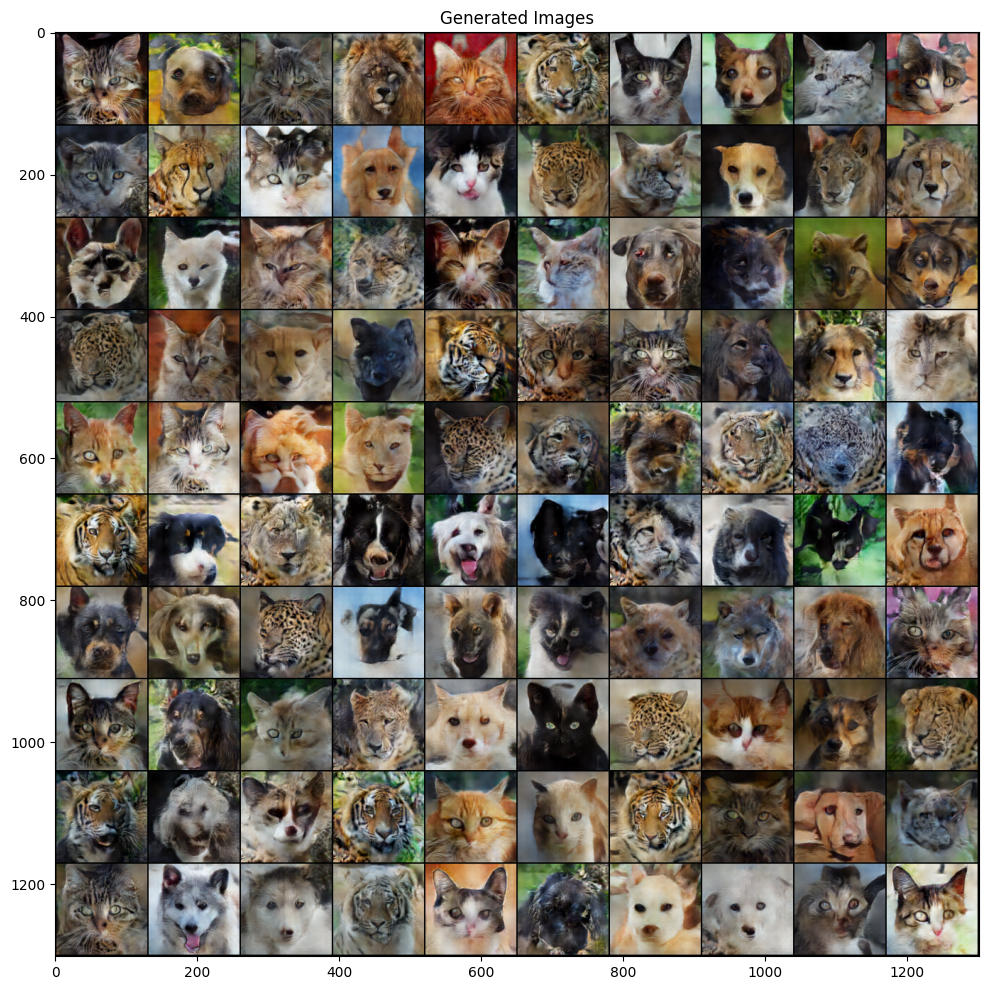

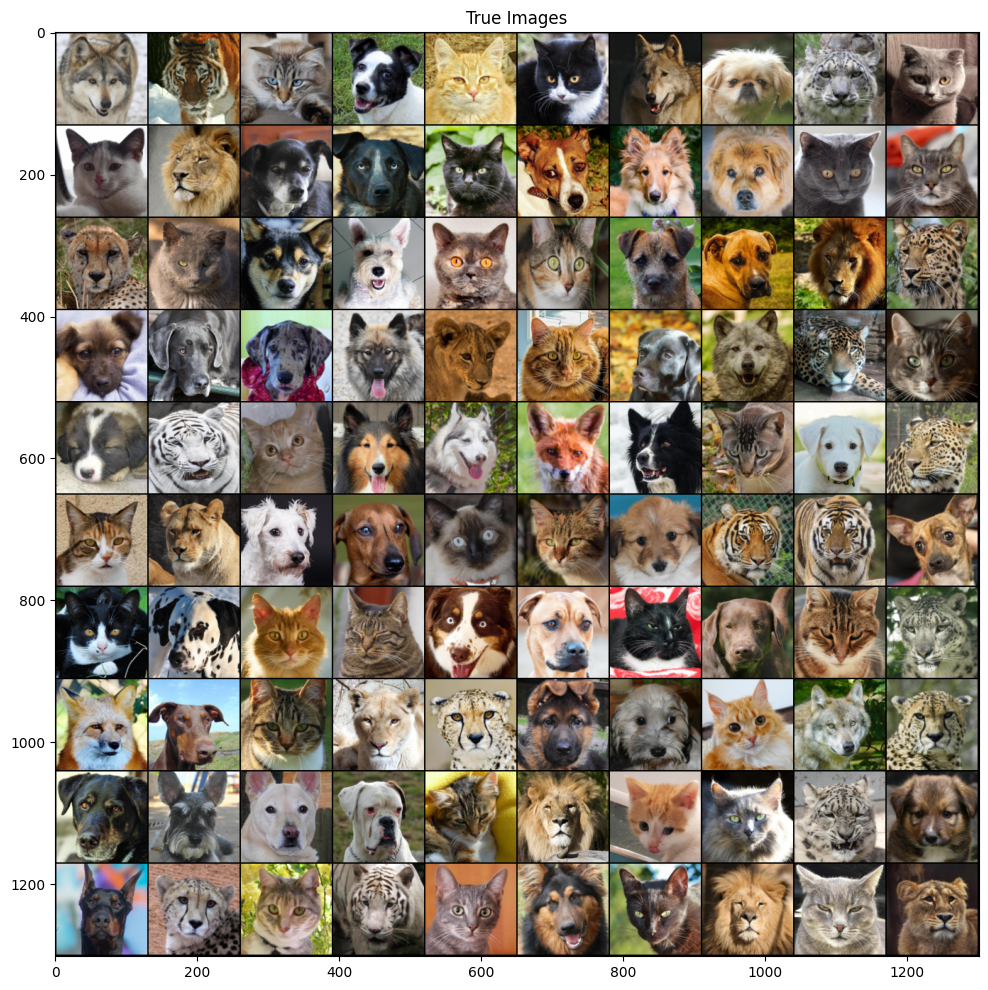

In [ ]:
noise = torch.randn(100, z_dim, 1, 1, device=device)
fake = generator(noise)
real_img,_ = next(iter(train_loader))
show_tensor_images(fake,'Generated Images')
show_tensor_images(real_img,'True Images')

## Load Saved State Dictionaries

In [ ]:
checkpoint = torch.load('.\Backup2\models_state_dict_dc_gan_199.tar')
generator.load_state_dict(checkpoint['G_state_dict'])
discriminator.load_state_dict(checkpoint['D_state_dict'])

<All keys matched successfully>

## Plot the loss curves

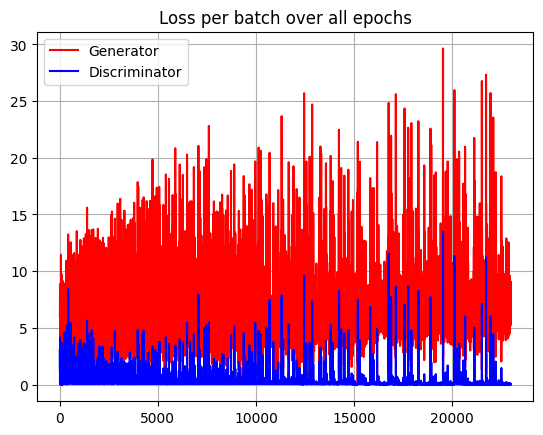

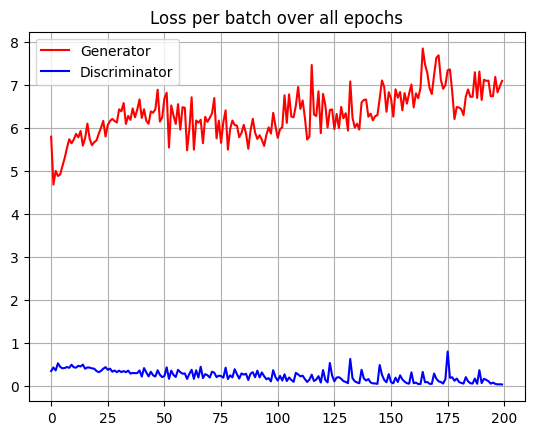

In [ ]:
# Function to plot Generator and Discriminator Loss curves
def plot_loss_curves(g_loss, d_loss, per_epoch=False):
    plt.plot(g_loss, color='r', label='Generator')
    plt.plot(d_loss, color='b', label='Discriminator')
    if per_epoch:
        plt.title("Loss per epoch")
    else:
        plt.title("Loss per batch over all epochs")
    plt.legend()
    plt.grid()
    plt.show()

plot_loss_curves(G_loss, D_loss)
plot_loss_curves(G_loss_per_epoch, D_loss_per_epoch)

## Calculate FID score for the generated images

#### With 1000 images

In [ ]:
# Function to get FID score
def get_fid_score(data_path, g_nw, transform, n_images=1000, max_epochs=1, z_dim=1):
    fid_metric = FID(device=device)
    fid_data = datasets.ImageFolder(data_path, transform=transform)
    def evaluation_step(engine, batch):
        with torch.no_grad():
            noise = torch.randn(batch[0].shape[0], z_dim , 1, 1, device=device)
            g_nw.eval()
            fake_batch = g_nw(noise)
            return fake_batch, batch[0]
    evaluator = Engine(evaluation_step)
    fid_metric.attach(evaluator, "fid")

    subset_indices = list(range(n_images)) # Create a SubsetRandomSamplersubset
    sampler = SubsetRandomSampler(subset_indices) # Create a DataLoader using the sampler
    fid_loader = DataLoader(fid_data, batch_size=n_images, sampler=sampler)
    evaluator.run(fid_loader,max_epochs=max_epochs)
    metrics = evaluator.state.metrics
    print("FID: {}".format(metrics['fid']))


get_fid_score(data_path, generator, transform, 1000, 1, z_dim=z_dim)

FID: 0.7445611572633266


#### FID with 5000 images across 5 epochs

The FID score improves with more number of images

In [ ]:
get_fid_score(data_path, generator, transform, 5000, 5, z_dim=z_dim)

FID: 0.6782125372110238


# Experiment 2: Different number of Generator and Discriminator train iterations

### Parameters

- Epochs : 200
- Learning rate: 2e-4
- Latent dimensions: 100
- Batch Size = 128
- Discriminator to Generator training ratio : 5


### Observations:

- The generated images are NOT comparable to the true images indicating that $P_{x}$ is NOT close to $P_{\hat{x}}$
- Need more epochs of training. Training the discriminator multiple times before Generator is slower compared to Experiment 1
- Sudden jumps in the Generator loss indicates that optimal condition is not reached

100%|██████████| 115/115 [00:17<00:00,  6.46it/s]



Epoch: 1/200: Generator loss: 6.5881, Discriminator loss: 0.2778


100%|██████████| 115/115 [00:14<00:00,  7.83it/s]



Epoch: 2/200: Generator loss: 4.1704, Discriminator loss: 0.0053


100%|██████████| 115/115 [00:14<00:00,  7.95it/s]



Epoch: 3/200: Generator loss: 4.1704, Discriminator loss: 0.0012


100%|██████████| 115/115 [00:14<00:00,  7.73it/s]



Epoch: 4/200: Generator loss: 4.1704, Discriminator loss: 0.0007


100%|██████████| 115/115 [00:14<00:00,  7.89it/s]



Epoch: 5/200: Generator loss: 4.1704, Discriminator loss: 0.0004


100%|██████████| 115/115 [00:14<00:00,  7.77it/s]



Epoch: 6/200: Generator loss: 5.7153, Discriminator loss: 0.4660


100%|██████████| 115/115 [00:14<00:00,  7.75it/s]



Epoch: 7/200: Generator loss: 4.1931, Discriminator loss: 0.0040


100%|██████████| 115/115 [00:14<00:00,  7.70it/s]



Epoch: 8/200: Generator loss: 4.1931, Discriminator loss: 0.0007


100%|██████████| 115/115 [00:14<00:00,  7.84it/s]



Epoch: 9/200: Generator loss: 4.1931, Discriminator loss: 0.0004


100%|██████████| 115/115 [00:14<00:00,  7.83it/s]



Epoch: 10/200: Generator loss: 4.1931, Discriminator loss: 0.0003


100%|██████████| 115/115 [00:14<00:00,  7.77it/s]



Epoch: 11/200: Generator loss: 4.8905, Discriminator loss: 0.3958


100%|██████████| 115/115 [00:14<00:00,  7.85it/s]



Epoch: 12/200: Generator loss: 5.8096, Discriminator loss: 0.0040


100%|██████████| 115/115 [00:14<00:00,  7.82it/s]



Epoch: 13/200: Generator loss: 5.8096, Discriminator loss: 0.0006


100%|██████████| 115/115 [00:14<00:00,  7.80it/s]



Epoch: 14/200: Generator loss: 5.8096, Discriminator loss: 0.0004


100%|██████████| 115/115 [00:14<00:00,  7.84it/s]



Epoch: 15/200: Generator loss: 5.8096, Discriminator loss: 0.0003


100%|██████████| 115/115 [00:15<00:00,  7.65it/s]



Epoch: 16/200: Generator loss: 5.0324, Discriminator loss: 0.4025


100%|██████████| 115/115 [00:14<00:00,  7.82it/s]



Epoch: 17/200: Generator loss: 3.4014, Discriminator loss: 0.0136


100%|██████████| 115/115 [00:14<00:00,  8.12it/s]



Epoch: 18/200: Generator loss: 3.4014, Discriminator loss: 0.0008


100%|██████████| 115/115 [00:14<00:00,  8.00it/s]



Epoch: 19/200: Generator loss: 3.4014, Discriminator loss: 0.0004


100%|██████████| 115/115 [00:14<00:00,  7.86it/s]



Epoch: 20/200: Generator loss: 3.4014, Discriminator loss: 0.0003


100%|██████████| 115/115 [00:14<00:00,  7.72it/s]



Epoch: 21/200: Generator loss: 5.5449, Discriminator loss: 0.3133


100%|██████████| 115/115 [00:14<00:00,  8.03it/s]



Epoch: 22/200: Generator loss: 4.6442, Discriminator loss: 0.0048


100%|██████████| 115/115 [00:14<00:00,  7.69it/s]



Epoch: 23/200: Generator loss: 4.6442, Discriminator loss: 0.0007


100%|██████████| 115/115 [00:14<00:00,  7.89it/s]



Epoch: 24/200: Generator loss: 4.6442, Discriminator loss: 0.0004


100%|██████████| 115/115 [00:14<00:00,  8.05it/s]



Epoch: 25/200: Generator loss: 4.6442, Discriminator loss: 0.0003


100%|██████████| 115/115 [00:15<00:00,  7.67it/s]



Epoch: 26/200: Generator loss: 5.9673, Discriminator loss: 0.3853


100%|██████████| 115/115 [00:14<00:00,  8.01it/s]



Epoch: 27/200: Generator loss: 3.6520, Discriminator loss: 0.0129


100%|██████████| 115/115 [00:14<00:00,  7.75it/s]



Epoch: 28/200: Generator loss: 3.6520, Discriminator loss: 0.0010


100%|██████████| 115/115 [00:14<00:00,  7.85it/s]



Epoch: 29/200: Generator loss: 3.6520, Discriminator loss: 0.0006


100%|██████████| 115/115 [00:14<00:00,  7.74it/s]



Epoch: 30/200: Generator loss: 3.6520, Discriminator loss: 0.0004


100%|██████████| 115/115 [00:14<00:00,  7.68it/s]



Epoch: 31/200: Generator loss: 6.0812, Discriminator loss: 0.3268


100%|██████████| 115/115 [00:14<00:00,  7.72it/s]



Epoch: 32/200: Generator loss: 10.4736, Discriminator loss: 0.0095


100%|██████████| 115/115 [00:14<00:00,  7.79it/s]



Epoch: 33/200: Generator loss: 10.4736, Discriminator loss: 0.0005


100%|██████████| 115/115 [00:15<00:00,  7.65it/s]



Epoch: 34/200: Generator loss: 10.4736, Discriminator loss: 0.0003


100%|██████████| 115/115 [00:14<00:00,  7.76it/s]



Epoch: 35/200: Generator loss: 10.4736, Discriminator loss: 0.0002


100%|██████████| 115/115 [00:14<00:00,  7.76it/s]



Epoch: 36/200: Generator loss: 6.0222, Discriminator loss: 0.3454


100%|██████████| 115/115 [00:15<00:00,  7.63it/s]



Epoch: 37/200: Generator loss: 5.0691, Discriminator loss: 0.0053


100%|██████████| 115/115 [00:14<00:00,  7.99it/s]



Epoch: 38/200: Generator loss: 5.0691, Discriminator loss: 0.0007


100%|██████████| 115/115 [00:14<00:00,  7.86it/s]



Epoch: 39/200: Generator loss: 5.0691, Discriminator loss: 0.0004


100%|██████████| 115/115 [00:15<00:00,  7.65it/s]



Epoch: 40/200: Generator loss: 5.0691, Discriminator loss: 0.0003


100%|██████████| 115/115 [00:14<00:00,  7.74it/s]



Epoch: 41/200: Generator loss: 6.4137, Discriminator loss: 0.4498


100%|██████████| 115/115 [00:14<00:00,  7.68it/s]



Epoch: 42/200: Generator loss: 4.3705, Discriminator loss: 0.0148


100%|██████████| 115/115 [00:14<00:00,  7.68it/s]



Epoch: 43/200: Generator loss: 4.3705, Discriminator loss: 0.0004


100%|██████████| 115/115 [00:14<00:00,  7.86it/s]



Epoch: 44/200: Generator loss: 4.3705, Discriminator loss: 0.0002


100%|██████████| 115/115 [00:14<00:00,  7.82it/s]



Epoch: 45/200: Generator loss: 4.3705, Discriminator loss: 0.0002


100%|██████████| 115/115 [00:14<00:00,  7.82it/s]



Epoch: 46/200: Generator loss: 6.6059, Discriminator loss: 0.3544


100%|██████████| 115/115 [00:14<00:00,  8.05it/s]



Epoch: 47/200: Generator loss: 6.3615, Discriminator loss: 0.0053


100%|██████████| 115/115 [00:14<00:00,  7.76it/s]



Epoch: 48/200: Generator loss: 6.3615, Discriminator loss: 0.0006


100%|██████████| 115/115 [00:14<00:00,  7.83it/s]



Epoch: 49/200: Generator loss: 6.3615, Discriminator loss: 0.0004


100%|██████████| 115/115 [00:14<00:00,  7.77it/s]



Epoch: 50/200: Generator loss: 6.3615, Discriminator loss: 0.0003


  0%|          | 0/115 [00:00<?, ?it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epcoh 50: Generator loss: 5.349624335423819, discriminator loss: 0.07620258698413032


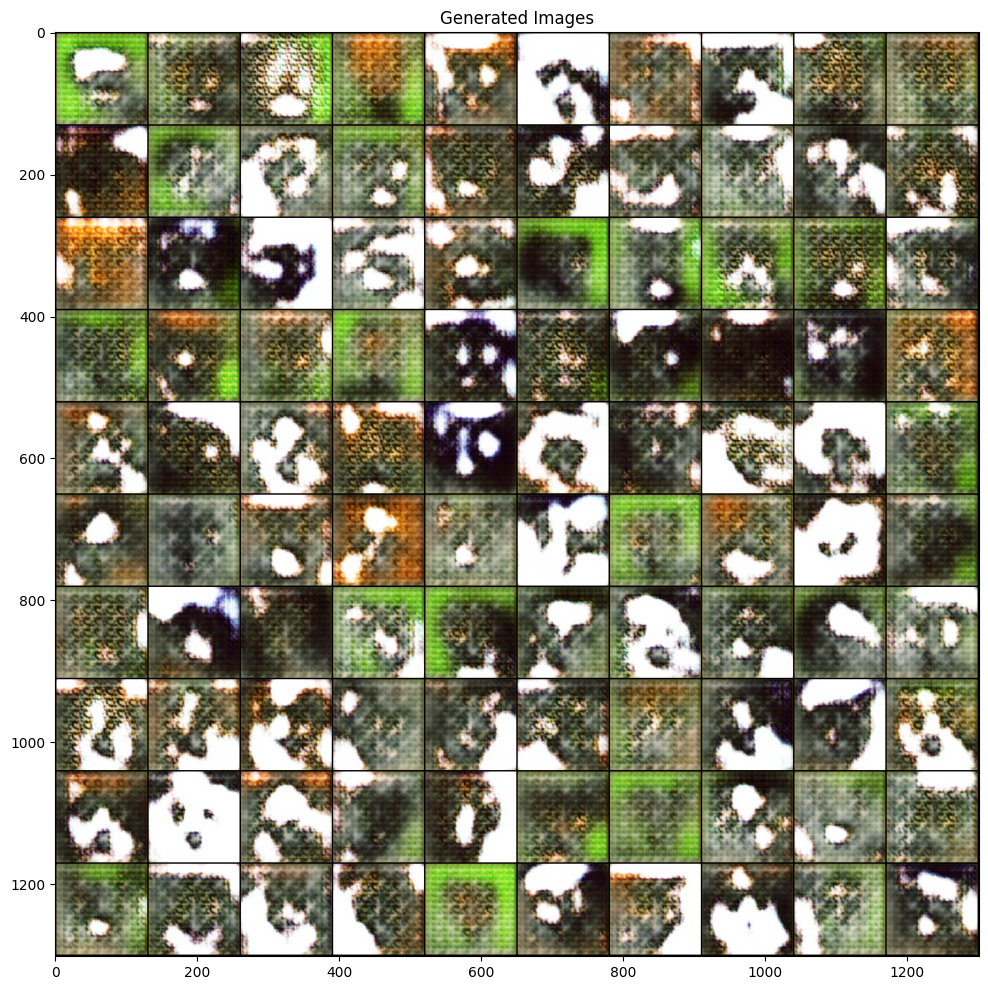

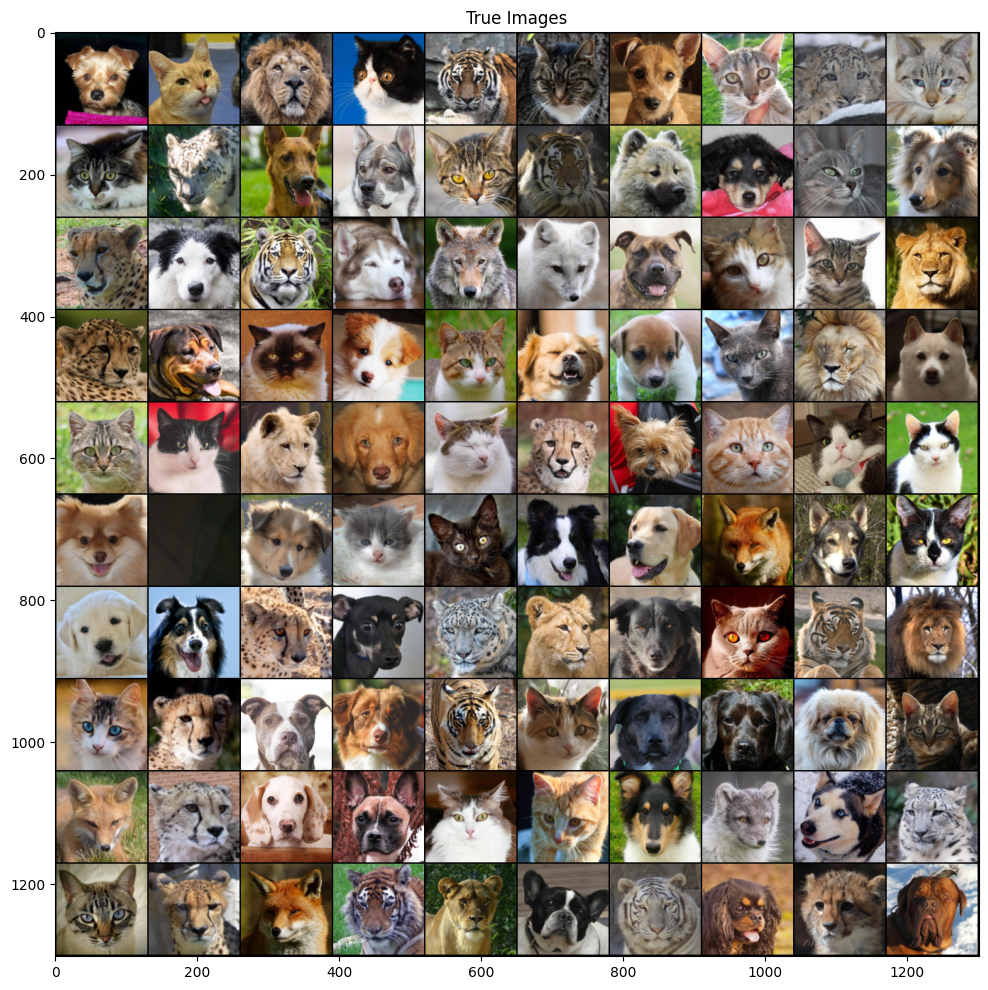

100%|██████████| 115/115 [00:15<00:00,  7.22it/s]



Epoch: 51/200: Generator loss: 6.1460, Discriminator loss: 0.3595


100%|██████████| 115/115 [00:14<00:00,  7.69it/s]



Epoch: 52/200: Generator loss: 7.1665, Discriminator loss: 0.0071


100%|██████████| 115/115 [00:15<00:00,  7.63it/s]



Epoch: 53/200: Generator loss: 7.1665, Discriminator loss: 0.0005


100%|██████████| 115/115 [00:14<00:00,  7.76it/s]



Epoch: 54/200: Generator loss: 7.1665, Discriminator loss: 0.0003


100%|██████████| 115/115 [00:14<00:00,  7.79it/s]



Epoch: 55/200: Generator loss: 7.1665, Discriminator loss: 0.0003


100%|██████████| 115/115 [00:14<00:00,  7.77it/s]



Epoch: 56/200: Generator loss: 6.8121, Discriminator loss: 0.3738


100%|██████████| 115/115 [00:14<00:00,  7.85it/s]



Epoch: 57/200: Generator loss: 9.1038, Discriminator loss: 0.0095


100%|██████████| 115/115 [00:14<00:00,  7.70it/s]



Epoch: 58/200: Generator loss: 9.1038, Discriminator loss: 0.0007


100%|██████████| 115/115 [00:14<00:00,  7.67it/s]



Epoch: 59/200: Generator loss: 9.1038, Discriminator loss: 0.0004


100%|██████████| 115/115 [00:14<00:00,  7.89it/s]



Epoch: 60/200: Generator loss: 9.1038, Discriminator loss: 0.0003


100%|██████████| 115/115 [00:14<00:00,  7.67it/s]



Epoch: 61/200: Generator loss: 6.5821, Discriminator loss: 0.3495


100%|██████████| 115/115 [00:15<00:00,  7.64it/s]



Epoch: 62/200: Generator loss: 5.6658, Discriminator loss: 0.0035


100%|██████████| 115/115 [00:14<00:00,  7.81it/s]



Epoch: 63/200: Generator loss: 5.6658, Discriminator loss: 0.0007


100%|██████████| 115/115 [00:14<00:00,  7.74it/s]



Epoch: 64/200: Generator loss: 5.6658, Discriminator loss: 0.0004


100%|██████████| 115/115 [00:14<00:00,  7.77it/s]



Epoch: 65/200: Generator loss: 5.6658, Discriminator loss: 0.0003


100%|██████████| 115/115 [00:14<00:00,  7.83it/s]



Epoch: 66/200: Generator loss: 7.1482, Discriminator loss: 0.4688


100%|██████████| 115/115 [00:14<00:00,  7.91it/s]



Epoch: 67/200: Generator loss: 11.6788, Discriminator loss: 0.0088


100%|██████████| 115/115 [00:14<00:00,  7.92it/s]



Epoch: 68/200: Generator loss: 11.6788, Discriminator loss: 0.0005


100%|██████████| 115/115 [00:14<00:00,  7.93it/s]



Epoch: 69/200: Generator loss: 11.6788, Discriminator loss: 0.0003


100%|██████████| 115/115 [00:14<00:00,  7.84it/s]



Epoch: 70/200: Generator loss: 11.6788, Discriminator loss: 0.0003


100%|██████████| 115/115 [00:14<00:00,  7.78it/s]



Epoch: 71/200: Generator loss: 6.8424, Discriminator loss: 0.3407


100%|██████████| 115/115 [00:14<00:00,  7.86it/s]



Epoch: 72/200: Generator loss: 4.6424, Discriminator loss: 0.0042


100%|██████████| 115/115 [00:14<00:00,  7.79it/s]



Epoch: 73/200: Generator loss: 4.6424, Discriminator loss: 0.0008


100%|██████████| 115/115 [00:14<00:00,  7.87it/s]



Epoch: 74/200: Generator loss: 4.6424, Discriminator loss: 0.0005


100%|██████████| 115/115 [00:14<00:00,  7.81it/s]



Epoch: 75/200: Generator loss: 4.6424, Discriminator loss: 0.0003


100%|██████████| 115/115 [00:14<00:00,  7.79it/s]



Epoch: 76/200: Generator loss: 6.5541, Discriminator loss: 0.4219


100%|██████████| 115/115 [00:15<00:00,  7.66it/s]



Epoch: 77/200: Generator loss: 7.8396, Discriminator loss: 0.0052


100%|██████████| 115/115 [00:14<00:00,  7.74it/s]



Epoch: 78/200: Generator loss: 7.8396, Discriminator loss: 0.0008


100%|██████████| 115/115 [00:14<00:00,  7.99it/s]



Epoch: 79/200: Generator loss: 7.8396, Discriminator loss: 0.0005


100%|██████████| 115/115 [00:14<00:00,  7.87it/s]



Epoch: 80/200: Generator loss: 7.8396, Discriminator loss: 0.0004


100%|██████████| 115/115 [00:14<00:00,  7.81it/s]



Epoch: 81/200: Generator loss: 7.2920, Discriminator loss: 0.3722


100%|██████████| 115/115 [00:14<00:00,  7.78it/s]



Epoch: 82/200: Generator loss: 5.4227, Discriminator loss: 0.0055


100%|██████████| 115/115 [00:15<00:00,  7.65it/s]



Epoch: 83/200: Generator loss: 5.4227, Discriminator loss: 0.0009


100%|██████████| 115/115 [00:14<00:00,  7.79it/s]



Epoch: 84/200: Generator loss: 5.4227, Discriminator loss: 0.0005


100%|██████████| 115/115 [00:14<00:00,  7.80it/s]



Epoch: 85/200: Generator loss: 5.4227, Discriminator loss: 0.0004


100%|██████████| 115/115 [00:15<00:00,  7.57it/s]



Epoch: 86/200: Generator loss: 7.1094, Discriminator loss: 0.3663


100%|██████████| 115/115 [00:14<00:00,  7.71it/s]



Epoch: 87/200: Generator loss: 3.7788, Discriminator loss: 0.0045


100%|██████████| 115/115 [00:14<00:00,  7.86it/s]



Epoch: 88/200: Generator loss: 3.7788, Discriminator loss: 0.0008


100%|██████████| 115/115 [00:14<00:00,  7.99it/s]



Epoch: 89/200: Generator loss: 3.7788, Discriminator loss: 0.0005


100%|██████████| 115/115 [00:14<00:00,  8.06it/s]



Epoch: 90/200: Generator loss: 3.7788, Discriminator loss: 0.0004


100%|██████████| 115/115 [00:14<00:00,  7.89it/s]



Epoch: 91/200: Generator loss: 7.0908, Discriminator loss: 0.3463


100%|██████████| 115/115 [00:14<00:00,  8.01it/s]



Epoch: 92/200: Generator loss: 5.8803, Discriminator loss: 0.0071


100%|██████████| 115/115 [00:14<00:00,  7.94it/s]



Epoch: 93/200: Generator loss: 5.8803, Discriminator loss: 0.0005


100%|██████████| 115/115 [00:14<00:00,  7.99it/s]



Epoch: 94/200: Generator loss: 5.8803, Discriminator loss: 0.0004


100%|██████████| 115/115 [00:14<00:00,  8.07it/s]



Epoch: 95/200: Generator loss: 5.8803, Discriminator loss: 0.0003


100%|██████████| 115/115 [00:15<00:00,  7.63it/s]



Epoch: 96/200: Generator loss: 7.2750, Discriminator loss: 0.3482


100%|██████████| 115/115 [00:14<00:00,  7.91it/s]



Epoch: 97/200: Generator loss: 6.7977, Discriminator loss: 0.0048


100%|██████████| 115/115 [00:14<00:00,  7.93it/s]



Epoch: 98/200: Generator loss: 6.7977, Discriminator loss: 0.0007


100%|██████████| 115/115 [00:14<00:00,  7.99it/s]



Epoch: 99/200: Generator loss: 6.7977, Discriminator loss: 0.0005


100%|██████████| 115/115 [00:14<00:00,  7.81it/s]



Epoch: 100/200: Generator loss: 6.7977, Discriminator loss: 0.0003


  0%|          | 0/115 [00:00<?, ?it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epcoh 100: Generator loss: 6.082356948166782, discriminator loss: 0.07632118126417342


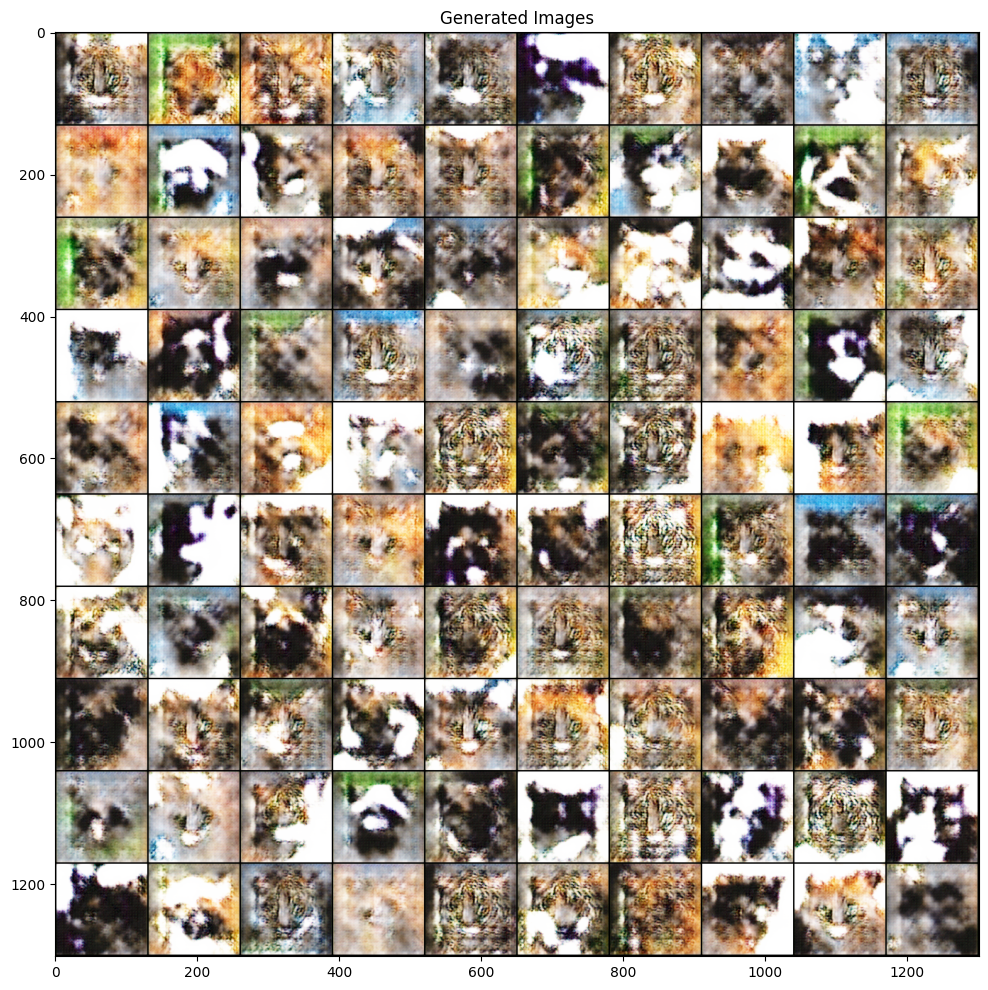

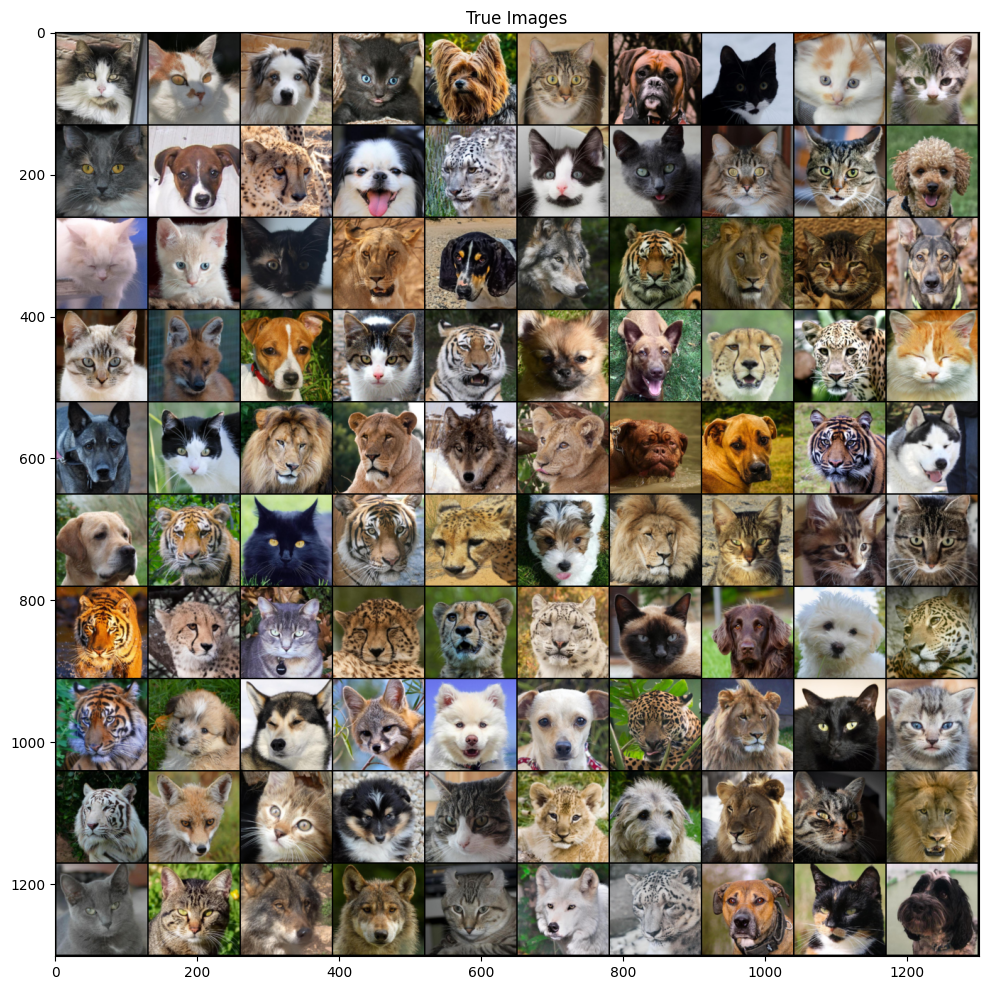

100%|██████████| 115/115 [00:15<00:00,  7.33it/s]



Epoch: 101/200: Generator loss: 7.2994, Discriminator loss: 0.3133


100%|██████████| 115/115 [00:14<00:00,  7.79it/s]



Epoch: 102/200: Generator loss: 4.8684, Discriminator loss: 0.0050


100%|██████████| 115/115 [00:14<00:00,  7.97it/s]



Epoch: 103/200: Generator loss: 4.8684, Discriminator loss: 0.0008


100%|██████████| 115/115 [00:14<00:00,  7.92it/s]



Epoch: 104/200: Generator loss: 4.8684, Discriminator loss: 0.0005


100%|██████████| 115/115 [00:14<00:00,  7.85it/s]



Epoch: 105/200: Generator loss: 4.8684, Discriminator loss: 0.0003


100%|██████████| 115/115 [00:14<00:00,  7.90it/s]



Epoch: 106/200: Generator loss: 7.0514, Discriminator loss: 0.4675


100%|██████████| 115/115 [00:14<00:00,  7.87it/s]



Epoch: 107/200: Generator loss: 4.2678, Discriminator loss: 0.0109


100%|██████████| 115/115 [00:14<00:00,  7.97it/s]



Epoch: 108/200: Generator loss: 4.2678, Discriminator loss: 0.0007


100%|██████████| 115/115 [00:14<00:00,  8.03it/s]



Epoch: 109/200: Generator loss: 4.2678, Discriminator loss: 0.0005


100%|██████████| 115/115 [00:14<00:00,  7.94it/s]



Epoch: 110/200: Generator loss: 4.2678, Discriminator loss: 0.0003


100%|██████████| 115/115 [00:14<00:00,  7.81it/s]



Epoch: 111/200: Generator loss: 7.2607, Discriminator loss: 0.3344


100%|██████████| 115/115 [00:14<00:00,  7.89it/s]



Epoch: 112/200: Generator loss: 5.8340, Discriminator loss: 0.0057


100%|██████████| 115/115 [00:14<00:00,  7.94it/s]



Epoch: 113/200: Generator loss: 5.8340, Discriminator loss: 0.0008


100%|██████████| 115/115 [00:14<00:00,  7.92it/s]



Epoch: 114/200: Generator loss: 5.8340, Discriminator loss: 0.0005


100%|██████████| 115/115 [00:14<00:00,  7.90it/s]



Epoch: 115/200: Generator loss: 5.8340, Discriminator loss: 0.0003


100%|██████████| 115/115 [00:14<00:00,  7.75it/s]



Epoch: 116/200: Generator loss: 7.2677, Discriminator loss: 0.2858


100%|██████████| 115/115 [00:14<00:00,  7.96it/s]



Epoch: 117/200: Generator loss: 6.3325, Discriminator loss: 0.0041


100%|██████████| 115/115 [00:14<00:00,  7.86it/s]



Epoch: 118/200: Generator loss: 6.3325, Discriminator loss: 0.0007


100%|██████████| 115/115 [00:14<00:00,  7.77it/s]



Epoch: 119/200: Generator loss: 6.3325, Discriminator loss: 0.0004


100%|██████████| 115/115 [00:14<00:00,  7.96it/s]



Epoch: 120/200: Generator loss: 6.3325, Discriminator loss: 0.0003


100%|██████████| 115/115 [00:14<00:00,  7.79it/s]



Epoch: 121/200: Generator loss: 7.9785, Discriminator loss: 0.3122


100%|██████████| 115/115 [00:14<00:00,  7.96it/s]



Epoch: 122/200: Generator loss: 9.8806, Discriminator loss: 0.0048


100%|██████████| 115/115 [00:14<00:00,  7.95it/s]



Epoch: 123/200: Generator loss: 9.8806, Discriminator loss: 0.0007


100%|██████████| 115/115 [00:14<00:00,  7.70it/s]



Epoch: 124/200: Generator loss: 9.8806, Discriminator loss: 0.0004


100%|██████████| 115/115 [00:14<00:00,  8.04it/s]



Epoch: 125/200: Generator loss: 9.8806, Discriminator loss: 0.0003


100%|██████████| 115/115 [00:14<00:00,  7.79it/s]



Epoch: 126/200: Generator loss: 7.4853, Discriminator loss: 0.3176


100%|██████████| 115/115 [00:14<00:00,  8.05it/s]



Epoch: 127/200: Generator loss: 6.1522, Discriminator loss: 0.0073


100%|██████████| 115/115 [00:14<00:00,  7.86it/s]



Epoch: 128/200: Generator loss: 6.1522, Discriminator loss: 0.0006


100%|██████████| 115/115 [00:14<00:00,  8.03it/s]



Epoch: 129/200: Generator loss: 6.1522, Discriminator loss: 0.0004


100%|██████████| 115/115 [00:14<00:00,  7.91it/s]



Epoch: 130/200: Generator loss: 6.1522, Discriminator loss: 0.0003


100%|██████████| 115/115 [00:14<00:00,  7.83it/s]



Epoch: 131/200: Generator loss: 7.6147, Discriminator loss: 0.3194


100%|██████████| 115/115 [00:14<00:00,  7.88it/s]



Epoch: 132/200: Generator loss: 7.2206, Discriminator loss: 0.0053


100%|██████████| 115/115 [00:14<00:00,  7.88it/s]



Epoch: 133/200: Generator loss: 7.2206, Discriminator loss: 0.0008


100%|██████████| 115/115 [00:14<00:00,  7.75it/s]



Epoch: 134/200: Generator loss: 7.2206, Discriminator loss: 0.0005


100%|██████████| 115/115 [00:14<00:00,  7.70it/s]



Epoch: 135/200: Generator loss: 7.2206, Discriminator loss: 0.0003


100%|██████████| 115/115 [00:14<00:00,  7.72it/s]



Epoch: 136/200: Generator loss: 7.3778, Discriminator loss: 0.2532


100%|██████████| 115/115 [00:14<00:00,  7.89it/s]



Epoch: 137/200: Generator loss: 7.4925, Discriminator loss: 0.0027


100%|██████████| 115/115 [00:14<00:00,  7.89it/s]



Epoch: 138/200: Generator loss: 7.4925, Discriminator loss: 0.0007


100%|██████████| 115/115 [00:14<00:00,  8.00it/s]



Epoch: 139/200: Generator loss: 7.4925, Discriminator loss: 0.0004


100%|██████████| 115/115 [00:14<00:00,  7.83it/s]



Epoch: 140/200: Generator loss: 7.4925, Discriminator loss: 0.0003


100%|██████████| 115/115 [00:14<00:00,  7.79it/s]



Epoch: 141/200: Generator loss: 8.1636, Discriminator loss: 0.2079


100%|██████████| 115/115 [00:14<00:00,  8.01it/s]



Epoch: 142/200: Generator loss: 7.8183, Discriminator loss: 0.0038


100%|██████████| 115/115 [00:14<00:00,  7.86it/s]



Epoch: 143/200: Generator loss: 7.8183, Discriminator loss: 0.0006


100%|██████████| 115/115 [00:14<00:00,  7.93it/s]



Epoch: 144/200: Generator loss: 7.8183, Discriminator loss: 0.0004


100%|██████████| 115/115 [00:14<00:00,  7.87it/s]



Epoch: 145/200: Generator loss: 7.8183, Discriminator loss: 0.0003


100%|██████████| 115/115 [00:14<00:00,  7.83it/s]



Epoch: 146/200: Generator loss: 7.9841, Discriminator loss: 0.3368


100%|██████████| 115/115 [00:14<00:00,  7.86it/s]



Epoch: 147/200: Generator loss: 10.7843, Discriminator loss: 0.0050


100%|██████████| 115/115 [00:14<00:00,  7.90it/s]



Epoch: 148/200: Generator loss: 10.7843, Discriminator loss: 0.0006


100%|██████████| 115/115 [00:14<00:00,  7.77it/s]



Epoch: 149/200: Generator loss: 10.7843, Discriminator loss: 0.0003


100%|██████████| 115/115 [00:14<00:00,  7.83it/s]



Epoch: 150/200: Generator loss: 10.7843, Discriminator loss: 0.0002


  0%|          | 0/115 [00:00<?, ?it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epcoh 150: Generator loss: 6.4421985689214845, discriminator loss: 0.07232699731875755


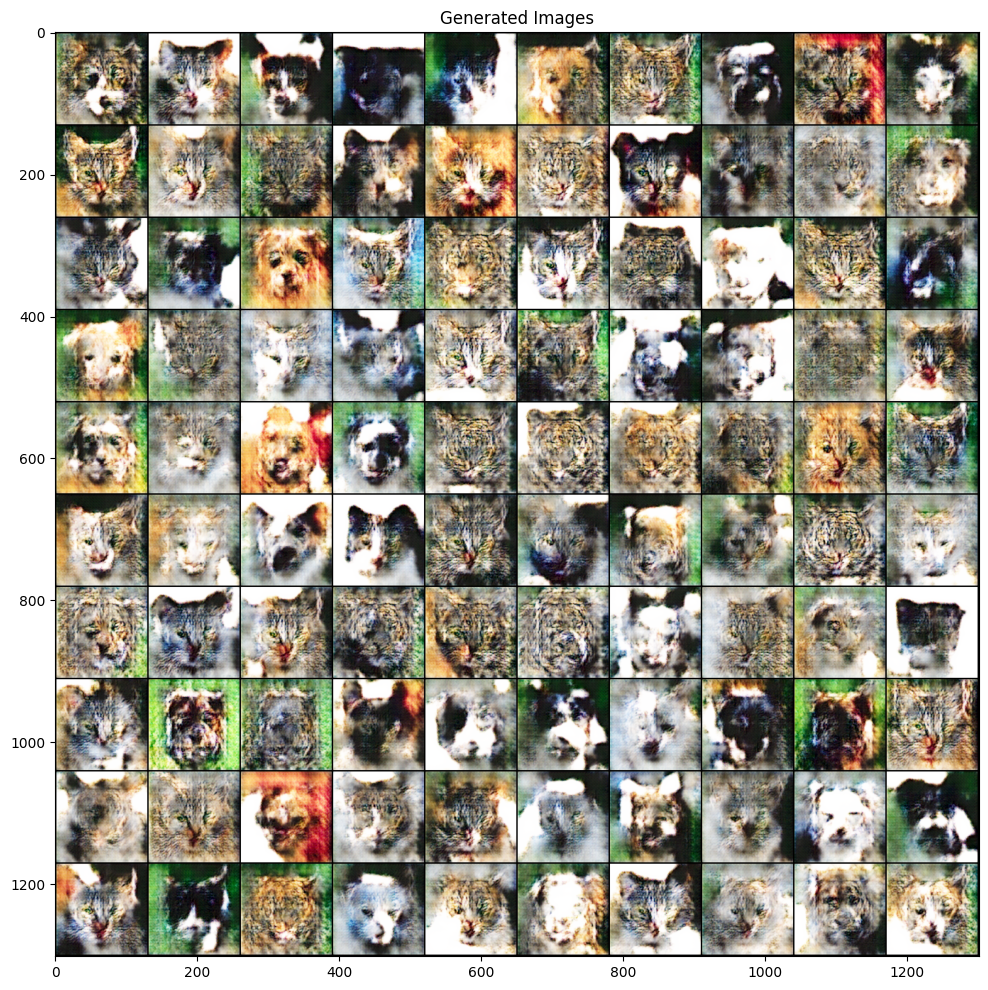

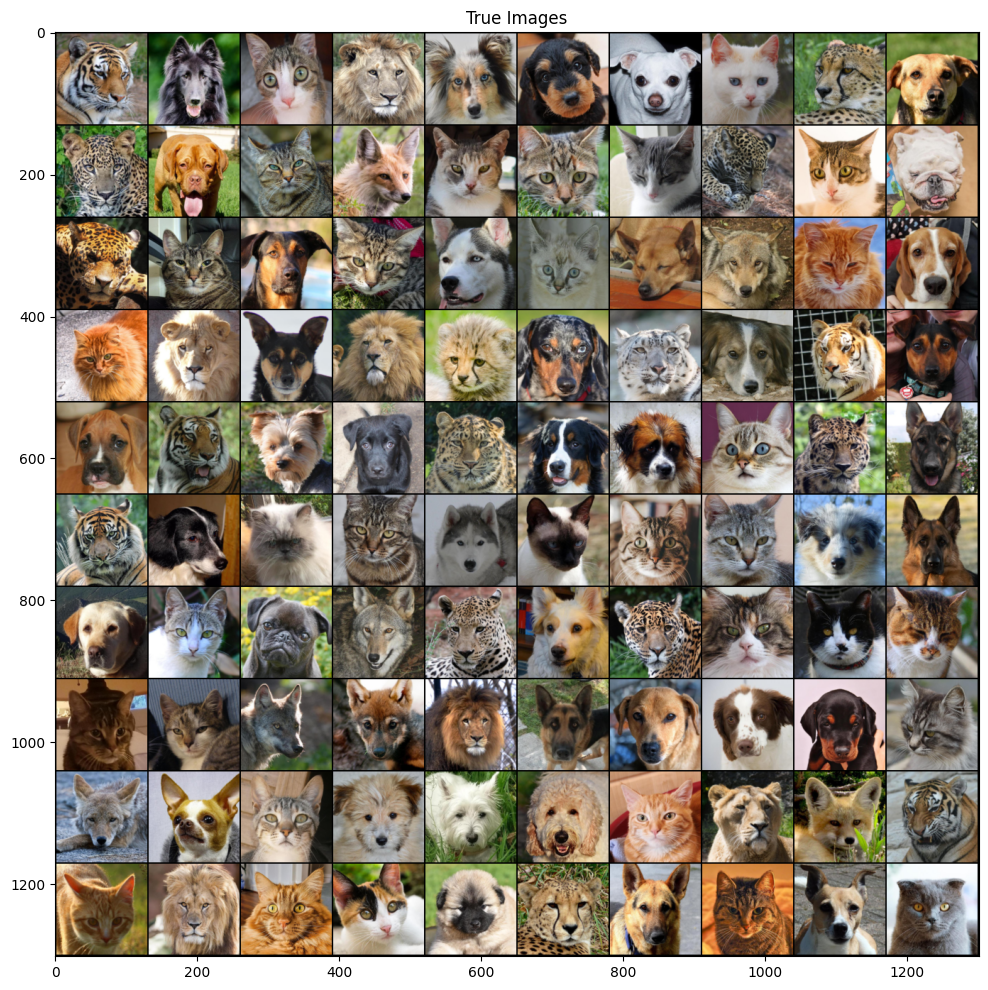

100%|██████████| 115/115 [00:15<00:00,  7.28it/s]



Epoch: 151/200: Generator loss: 7.9421, Discriminator loss: 0.3009


100%|██████████| 115/115 [00:14<00:00,  8.02it/s]



Epoch: 152/200: Generator loss: 6.0607, Discriminator loss: 0.0032


100%|██████████| 115/115 [00:14<00:00,  7.91it/s]



Epoch: 153/200: Generator loss: 6.0607, Discriminator loss: 0.0007


100%|██████████| 115/115 [00:14<00:00,  7.97it/s]



Epoch: 154/200: Generator loss: 6.0607, Discriminator loss: 0.0004


100%|██████████| 115/115 [00:14<00:00,  7.87it/s]



Epoch: 155/200: Generator loss: 6.0607, Discriminator loss: 0.0003


100%|██████████| 115/115 [00:14<00:00,  7.70it/s]



Epoch: 156/200: Generator loss: 7.9911, Discriminator loss: 0.2972


100%|██████████| 115/115 [00:14<00:00,  7.92it/s]



Epoch: 157/200: Generator loss: 7.3700, Discriminator loss: 0.0048


100%|██████████| 115/115 [00:14<00:00,  7.93it/s]



Epoch: 158/200: Generator loss: 7.3700, Discriminator loss: 0.0007


100%|██████████| 115/115 [00:14<00:00,  7.89it/s]



Epoch: 159/200: Generator loss: 7.3700, Discriminator loss: 0.0005


100%|██████████| 115/115 [00:14<00:00,  7.72it/s]



Epoch: 160/200: Generator loss: 7.3700, Discriminator loss: 0.0003


100%|██████████| 115/115 [00:14<00:00,  7.68it/s]



Epoch: 161/200: Generator loss: 7.8669, Discriminator loss: 0.2270


100%|██████████| 115/115 [00:14<00:00,  7.90it/s]



Epoch: 162/200: Generator loss: 6.1424, Discriminator loss: 0.0038


100%|██████████| 115/115 [00:14<00:00,  7.88it/s]



Epoch: 163/200: Generator loss: 6.1424, Discriminator loss: 0.0005


100%|██████████| 115/115 [00:14<00:00,  8.06it/s]



Epoch: 164/200: Generator loss: 6.1424, Discriminator loss: 0.0003


100%|██████████| 115/115 [00:14<00:00,  7.95it/s]



Epoch: 165/200: Generator loss: 6.1424, Discriminator loss: 0.0002


100%|██████████| 115/115 [00:14<00:00,  7.79it/s]



Epoch: 166/200: Generator loss: 8.2395, Discriminator loss: 0.3175


100%|██████████| 115/115 [00:14<00:00,  7.72it/s]



Epoch: 167/200: Generator loss: 13.8296, Discriminator loss: 0.0071


100%|██████████| 115/115 [00:14<00:00,  7.95it/s]



Epoch: 168/200: Generator loss: 13.8296, Discriminator loss: 0.0005


100%|██████████| 115/115 [00:14<00:00,  7.85it/s]



Epoch: 169/200: Generator loss: 13.8296, Discriminator loss: 0.0003


100%|██████████| 115/115 [00:14<00:00,  7.95it/s]



Epoch: 170/200: Generator loss: 13.8296, Discriminator loss: 0.0002


100%|██████████| 115/115 [00:14<00:00,  7.84it/s]



Epoch: 171/200: Generator loss: 8.1348, Discriminator loss: 0.2630


100%|██████████| 115/115 [00:14<00:00,  7.93it/s]



Epoch: 172/200: Generator loss: 6.9977, Discriminator loss: 0.0059


100%|██████████| 115/115 [00:14<00:00,  7.79it/s]



Epoch: 173/200: Generator loss: 6.9977, Discriminator loss: 0.0008


100%|██████████| 115/115 [00:14<00:00,  7.83it/s]



Epoch: 174/200: Generator loss: 6.9977, Discriminator loss: 0.0004


100%|██████████| 115/115 [00:14<00:00,  7.99it/s]



Epoch: 175/200: Generator loss: 6.9977, Discriminator loss: 0.0003


100%|██████████| 115/115 [00:14<00:00,  7.79it/s]



Epoch: 176/200: Generator loss: 7.9173, Discriminator loss: 0.3096


100%|██████████| 115/115 [00:14<00:00,  7.90it/s]



Epoch: 177/200: Generator loss: 4.9350, Discriminator loss: 0.0035


100%|██████████| 115/115 [00:14<00:00,  7.93it/s]



Epoch: 178/200: Generator loss: 4.9350, Discriminator loss: 0.0007


100%|██████████| 115/115 [00:14<00:00,  7.90it/s]



Epoch: 179/200: Generator loss: 4.9350, Discriminator loss: 0.0004


100%|██████████| 115/115 [00:14<00:00,  7.93it/s]



Epoch: 180/200: Generator loss: 4.9350, Discriminator loss: 0.0003


100%|██████████| 115/115 [00:14<00:00,  7.79it/s]



Epoch: 181/200: Generator loss: 7.9630, Discriminator loss: 0.2443


100%|██████████| 115/115 [00:14<00:00,  7.88it/s]



Epoch: 182/200: Generator loss: 5.1841, Discriminator loss: 0.0054


100%|██████████| 115/115 [00:14<00:00,  8.07it/s]



Epoch: 183/200: Generator loss: 5.1841, Discriminator loss: 0.0005


100%|██████████| 115/115 [00:14<00:00,  7.95it/s]



Epoch: 184/200: Generator loss: 5.1841, Discriminator loss: 0.0003


100%|██████████| 115/115 [00:14<00:00,  7.98it/s]



Epoch: 185/200: Generator loss: 5.1841, Discriminator loss: 0.0002


100%|██████████| 115/115 [00:14<00:00,  7.77it/s]



Epoch: 186/200: Generator loss: 8.0640, Discriminator loss: 0.1993


100%|██████████| 115/115 [00:14<00:00,  8.01it/s]



Epoch: 187/200: Generator loss: 13.7908, Discriminator loss: 0.0047


100%|██████████| 115/115 [00:14<00:00,  8.03it/s]



Epoch: 188/200: Generator loss: 13.7908, Discriminator loss: 0.0006


100%|██████████| 115/115 [00:14<00:00,  8.01it/s]



Epoch: 189/200: Generator loss: 13.7908, Discriminator loss: 0.0004


100%|██████████| 115/115 [00:13<00:00,  8.29it/s]



Epoch: 190/200: Generator loss: 13.7908, Discriminator loss: 0.0003


100%|██████████| 115/115 [00:14<00:00,  7.75it/s]



Epoch: 191/200: Generator loss: 8.3228, Discriminator loss: 0.2768


100%|██████████| 115/115 [00:14<00:00,  8.01it/s]



Epoch: 192/200: Generator loss: 5.2649, Discriminator loss: 0.0315


100%|██████████| 115/115 [00:14<00:00,  8.07it/s]



Epoch: 193/200: Generator loss: 5.2649, Discriminator loss: 0.0003


100%|██████████| 115/115 [00:14<00:00,  8.07it/s]



Epoch: 194/200: Generator loss: 5.2649, Discriminator loss: 0.0002


100%|██████████| 115/115 [00:14<00:00,  7.88it/s]



Epoch: 195/200: Generator loss: 5.2649, Discriminator loss: 0.0002


100%|██████████| 115/115 [00:14<00:00,  7.77it/s]



Epoch: 196/200: Generator loss: 7.9359, Discriminator loss: 0.2009


100%|██████████| 115/115 [00:14<00:00,  8.06it/s]



Epoch: 197/200: Generator loss: 6.7309, Discriminator loss: 0.0032


100%|██████████| 115/115 [00:14<00:00,  7.97it/s]



Epoch: 198/200: Generator loss: 6.7309, Discriminator loss: 0.0006


100%|██████████| 115/115 [00:21<00:00,  5.41it/s]



Epoch: 199/200: Generator loss: 6.7309, Discriminator loss: 0.0003


100%|██████████| 115/115 [00:34<00:00,  3.34it/s]


Epoch: 200/200: Generator loss: 6.7309, Discriminator loss: 0.0002


In [ ]:
# Training the GAN

# Lists to keep track of progress
img_list = []
G_loss = []
D_loss = []
G_loss_epoch = []
D_loss_epoch = []
G_loss_per_epoch = []
D_loss_per_epoch = []
print_stat_after_n_epoch = 50

# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    done_print = False
    for i, data in tqdm(enumerate(train_loader, 0),total=len(train_loader),colour='GREEN'):
        real_img = data[0].to(device)
        b_size = real_img.size(0)
        noise = torch.randn(b_size, z_dim, 1, 1, device=device)
        # Generate fake image batch with G
        fake = generator(noise)
        discriminator.zero_grad()

        # maximize log(D(x)) + log(1 - D(G(z)))
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        if epoch % 1 == 0:
            b_size = real_img.size(0)
            label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
            output = discriminator(real_img).view(-1)
            errD_real = criterion(output, label)
            errD_real.backward()
            D_x = output.mean().item()

            noise = torch.randn(b_size, z_dim, 1, 1, device=device)
            fake = generator(noise)
            label.fill_(fake_label)
            output = discriminator(fake.detach()).view(-1)
            errD_fake = criterion(output, label)

            # Gradients for this batch
            errD_fake.backward()
            D_G_z1 = output.mean().item()
            errD = errD_real + errD_fake

            # Update Discriminator
            optimizerD.step()

        # maximize log(D(G(z)))
        if epoch % 5 == 0:
            generator.zero_grad()
            label.fill_(real_label)
            output = discriminator(fake).view(-1)
            errG = criterion(output, label)

            # Calculate gradients for Generator
            errG.backward()
            D_G_z2 = output.mean().item()

            # Update Generator
            optimizerG.step()

        # Save Losses for plotting later
        G_loss.append(errG.item())
        G_loss_epoch.append(errG.item())
        D_loss.append(errD.item())
        D_loss_epoch.append(errD.item())


        if epoch % print_stat_after_n_epoch == 0 and epoch > 0 and not done_print:
            print(f"Epcoh {epoch}: Generator loss: {np.mean(G_loss)}, discriminator loss: {np.mean(D_loss)}")
            show_tensor_images(fake,'Generated Images')
            show_tensor_images(real_img,'True Images')
            done_print = True

    print(f"\nEpoch: {epoch+1}/{num_epochs}: Generator loss: {np.mean(G_loss_epoch):.4f}, Discriminator loss: {np.mean(D_loss_epoch):.4f}")
    G_loss_per_epoch.append(np.mean(G_loss_epoch))
    D_loss_per_epoch.append(np.mean(D_loss_epoch))
    G_loss_epoch = []
    D_loss_epoch = []

    # Save model at every 50 epochs
    if (epoch+1) % 50 == 0:
        torch.save({
                'D_state_dict': discriminator.state_dict(),
                'G_state_dict': generator.state_dict(),
                'optimizer_D_state_dict': optimizerD.state_dict(),
                'optimizer_EG_state_dict': optimizerG.state_dict(),
                }, '.\models_state_dict_dc_gan_{}.tar'.format(epoch))

#show_tensor_images(fake)
#show_tensor_images(real_cpu)

#### Generated images after 200 epochs can be found below.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


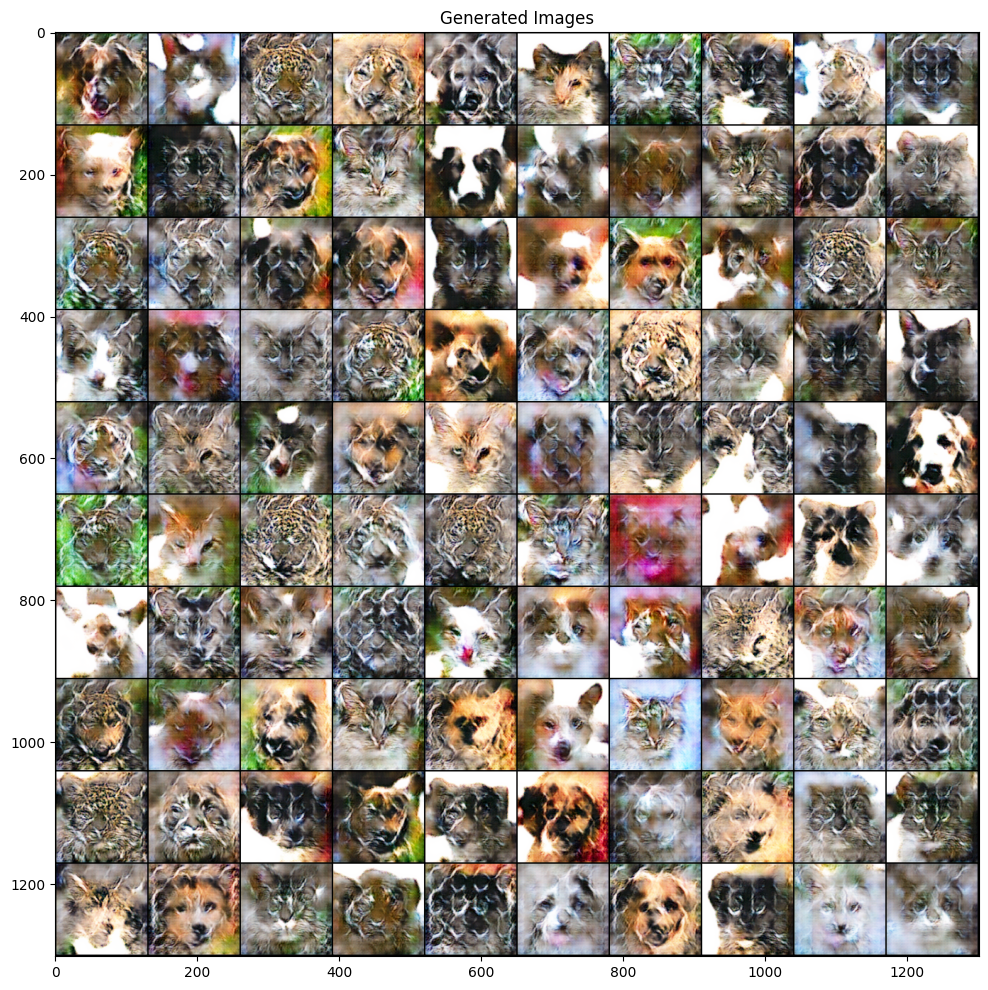

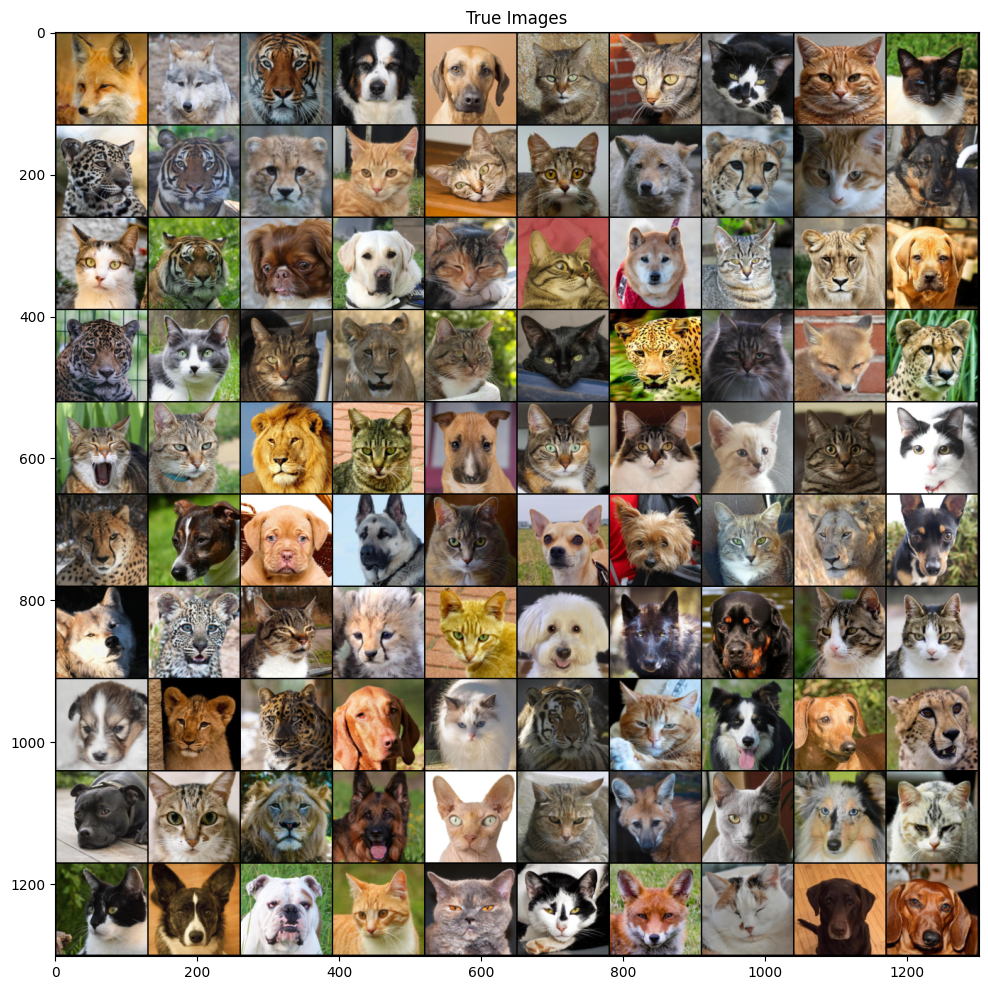

In [ ]:
noise = torch.randn(100, z_dim, 1, 1, device=device)
fake = generator(noise)
real_img,_ = next(iter(train_loader))
show_tensor_images(fake,'Generated Images')
show_tensor_images(real_img,'True Images')

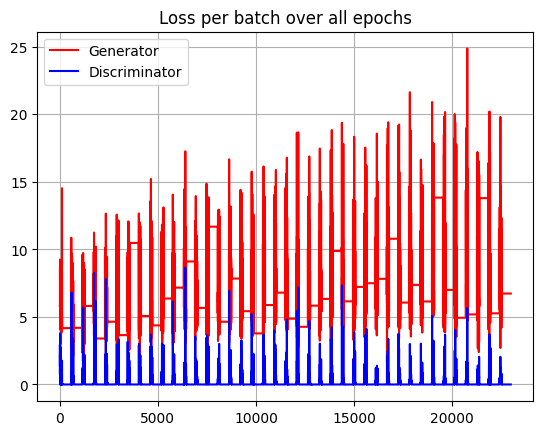

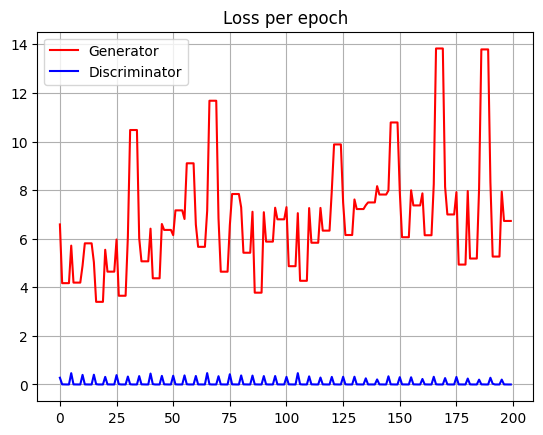

In [ ]:
plot_loss_curves(G_loss, D_loss,per_epoch=False)
plot_loss_curves(G_loss_per_epoch, D_loss_per_epoch,per_epoch=True)

In [ ]:
get_fid_score(data_path, generator, transform, 1000, 1, z_dim=z_dim)

FID: 0.7417797865904304
